# EECE 5644 - Intro to Machine Learning - Final Project: EDA and Musical Genre Classification

## Tyler's Code

#### Imports

In [2]:
import os
os.environ["OMP_NUM_THREADS"] = "4" # export OMP_NUM_THREADS=4
os.environ["OPENBLAS_NUM_THREADS"] = "4" # export OPENBLAS_NUM_THREADS=4 
os.environ["MKL_NUM_THREADS"] = "6" # export MKL_NUM_THREADS=6
os.environ["VECLIB_MAXIMUM_THREADS"] = "4" # export VECLIB_MAXIMUM_THREADS=4
os.environ["NUMEXPR_NUM_THREADS"] = "6" # export NUMEXPR_NUM_THREADS=6
# Audio Processing and Display Modules
import IPython.display as ipy       # Playing Audio Samples
import librosa as lib               # Spectrograms 
import librosa.display as libdis    # Wavefrom Plots
import seaborn as sns               # Additional Plotting
import sweetviz as sv               # Visual Aid
# Machine Learning Modules
import sklearn
from sklearn.naive_bayes import GaussianNB, MultinomialNB
from sklearn.linear_model import SGDClassifier, LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.cluster import KMeans
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC, LinearSVC
from sklearn.neural_network import MLPClassifier
import xgboost as xgb
from xgboost import XGBClassifier, XGBRFClassifier
from xgboost import plot_tree, plot_importance, to_graphviz
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.metrics import plot_confusion_matrix, confusion_matrix, accuracy_score, roc_auc_score, roc_curve
from sklearn.metrics import balanced_accuracy_score, make_scorer
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, StratifiedKFold, KFold
from sklearn.linear_model import Lasso
from sklearn.decomposition import PCA
from sklearn.feature_selection import RFE
# Standard Python Modules 
import pandas as pd     
import random as rnd        
import numpy as np 
import matplotlib.pylab as plt
plt.style.use('ggplot')
pd.options.display.max_columns = 60
pd.options.display.max_rows = 50

#### Function for Model Evaluation

In [3]:
def model_assess(model, X_train, y_train, X_test, y_test, title = "Default"):
    model.fit(X_train, y_train)
    preds = model.predict(X_test)
    #print(confusion_matrix(y_test, preds))
    print('Accuracy', title, ':', round(accuracy_score(y_test, preds), 5), '\n')

#### Functions

In [59]:
def SampleRandomSong(df, song):
    idx = rnd.randint(0,99)
    df = df.query(r'label == "{val}"'.format(val = song)).reset_index(drop=True).iloc[idx]
    audio_path = r"C:\Users\tmcke\OneDrive\Desktop\NORTHEASTERN\Fall 2022\Intro to Machine Learning\Python Files\GTZAN Dataset\genres_original\{val1}\{val2}".format(val1 = song,val2 = str(df[0]))  
    return df, audio_path  
# Normalising the spectral centroid for visualisation
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)

#### Input GTZAN Datasets (3 sec and 30 sec)

In [208]:
# Read CSV file of 10 genres of Music
df = pd.read_csv('features_3_sec.csv')
df_30sec = pd.read_csv('features_30_sec.csv')

In [ ]:
# Display Dataframe
df_30sec

In [256]:
# Dimensions of 3 sec features dataframe
df.shape
# List the dtype for each column of Dataframe
#df.dtypes

(9990, 60)

In [ ]:
# List all the columns of Dataframe
df.columns

### Listen to Random Music Tracks from GTZAN Dataset

### Rock Song

In [60]:
seriesRock, audioPath = SampleRandomSong(df_30sec,"rock")
x,sr = lib.load(audioPath)
ipy.Audio(audioPath)

#### Time-Domain Waveform: Rock Song

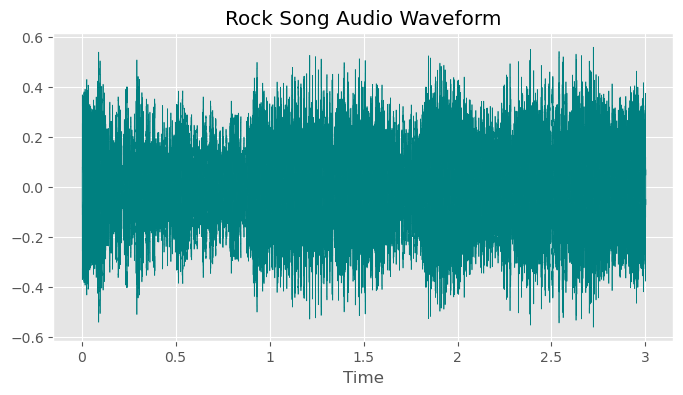

In [61]:
# Sample first 3 seconds from random genre song
x1 = x[0:66139]
plt.figure(figsize=(8,4))
libdis.waveshow(x1,sr=sr, color = 'teal')
plt.title('Rock Song Audio Waveform')
plt.show()

#### Spectrogram: Rock Song
- Visual representation of the spectrum of frequencies versus time. 
- Intensity of signal at various frequencies over time

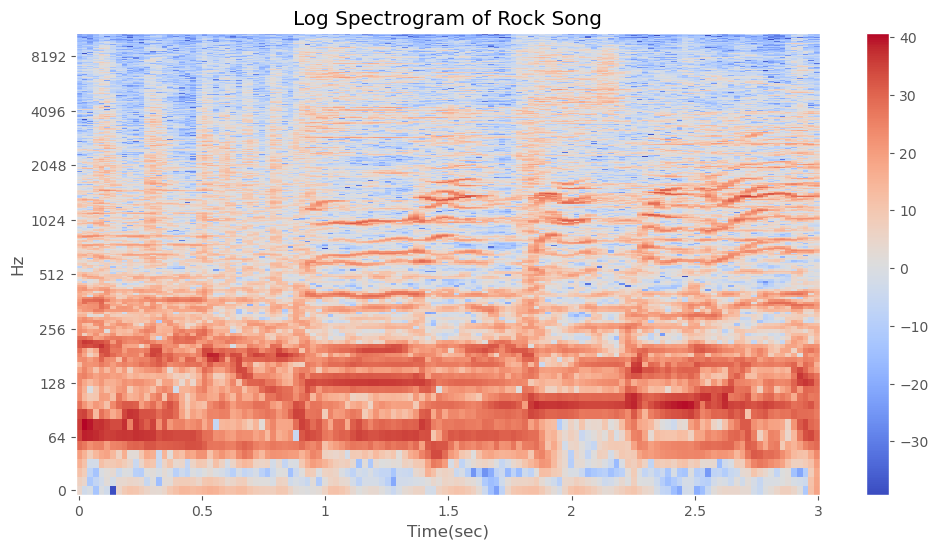

In [62]:
X = lib.stft(x1)                                            # Compute Spectrogram of 3 sec Rock Sample
Xdb = lib.amplitude_to_db(abs(X))                           # Convert Amplitude to Decibels
plt.figure(figsize=(12, 6))
libdis.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')    # Librosa Display Log Spectrogram
plt.colorbar()
plt.xlabel('Time(sec)')
plt.ylabel('Hz')
plt.title('Log Spectrogram of Rock Song')
plt.show()

#### Zero-Crossing Rate (Zoomed-In Section of 3 sec Audio)
- Rate of sign-changes of signal
- Rate at which the audio signal changes from positive to negative and back

The Number of Zero-Crossings for Zoomed-In Audio Waveform is: 5


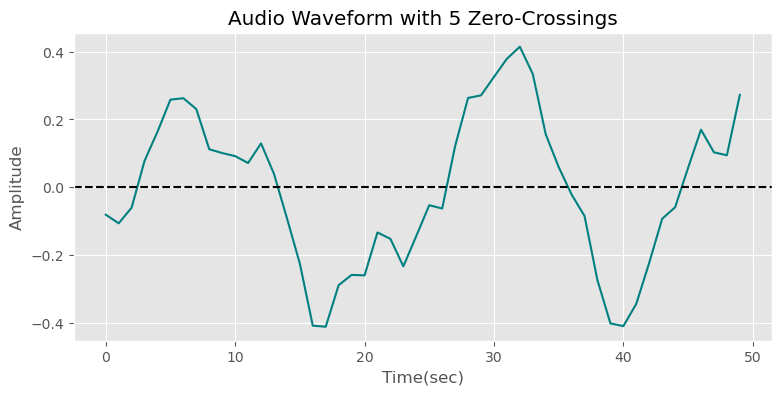

In [21]:
# Zooming in
n0 = 5050
n1 = 5100
numZeroCross = sum(lib.zero_crossings(x1[n0:n1], pad=False))
print(r"The Number of Zero-Crossings for Zoomed-In Audio Waveform is: {val}".format(val = numZeroCross))
plt.figure(figsize=(9, 4))
plt.plot(x1[n0:n1], color = 'teal')
plt.axhline(y=0, color='k', linestyle='--')
plt.xlabel('Time(sec)')
plt.ylabel('Amplitude')
plt.title(r"Audio Waveform with {val} Zero-Crossings".format(val = numZeroCross))
plt.grid(True)

#### Spectral Centroids
- Indicates where the centroid of the audio spectrogram is located
- Calculated as weighted mean of frequencies present in the audio

C:\Users\tmcke\AppData\Local\Temp\ipykernel_25904\3320952454.py:1: FutureWarning: Pass y=[0.3352661  0.1633606  0.08322144 ... 0.37353516 0.40194702 0.42190552] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  spectral_centroids = lib.feature.spectral_centroid(x1, sr=sr)[0]


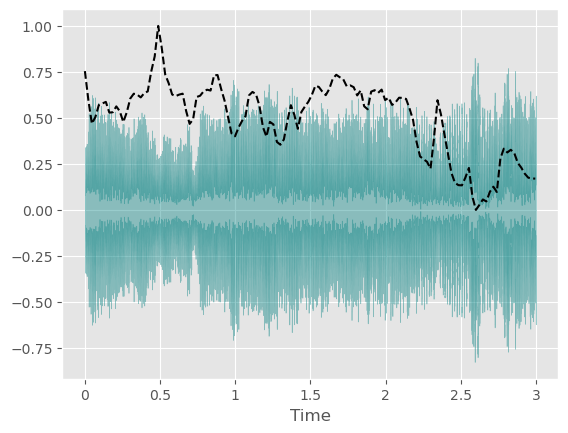

In [22]:
spectral_centroids = lib.feature.spectral_centroid(x1, sr=sr)[0]
# Computing the time variable for visualization
frames = range(len(spectral_centroids))
t = lib.frames_to_time(frames)
#Plotting the Spectral Centroid along the waveform
libdis.waveshow(x1, sr=sr, alpha=0.4, color = 'teal')
plt.plot(t, normalize(spectral_centroids), color='k',linestyle = '--')
plt.show()

#### Spectral Rolloff
- Measurement of the shape of audio
- Represents frequency below a specified percentage of total spectral energy

C:\Users\tmcke\AppData\Local\Temp\ipykernel_25904\407351742.py:1: FutureWarning: Pass y=[0.3452661  0.1733606  0.09322143 ... 0.38353515 0.411947   0.4319055 ] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  spectral_rolloff = lib.feature.spectral_rolloff(x1+0.01, sr=sr)[0]


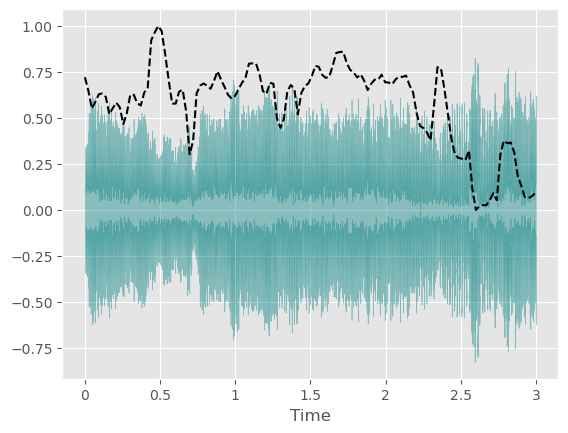

In [24]:
spectral_rolloff = lib.feature.spectral_rolloff(x1+0.01, sr=sr)[0]
lib.display.waveshow(x1, sr=sr, alpha=0.4, color = 'teal')
plt.plot(t, normalize(spectral_rolloff), color='k',linestyle = '--')
plt.show()

#### Mel-Frequency Cepstral Coefficients
- Small set of features (btw 10-20)
- Concisely describe the overall shape of spectral envelope 
- Models characteristics of the human voice

C:\Users\tmcke\AppData\Local\Temp\ipykernel_2744\512006153.py:1: FutureWarning: Pass y=[0.07925415 0.05932617 0.03930664 ... 0.03674316 0.05004883 0.13900757] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfccs = lib.feature.mfcc(x1, sr=sr)


(20, 130)


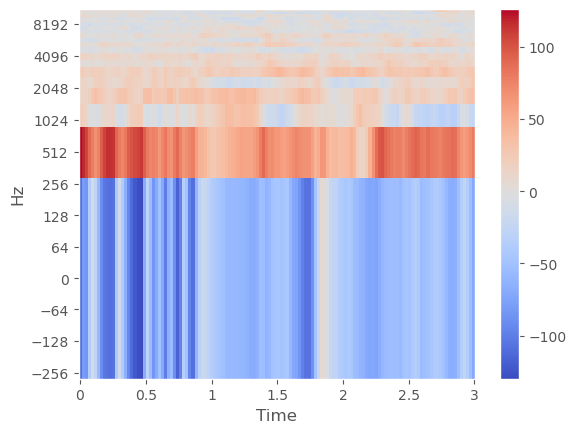

In [63]:
mfccs = lib.feature.mfcc(x1, sr=sr)
print(mfccs.shape)
#Displaying  the MFCCs:
lib.display.specshow(mfccs, sr=sr, x_axis='time', y_axis = 'log')
plt.colorbar()
plt.show()

c:\Users\tmcke\anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:239: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
c:\Users\tmcke\anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:258: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


The Mean for the Mel-Frequency Cepstral Coefficients are: -7.335956286880219e-10
The Variance for the Mel-Frequency Cepstral Coefficients are: 1.0


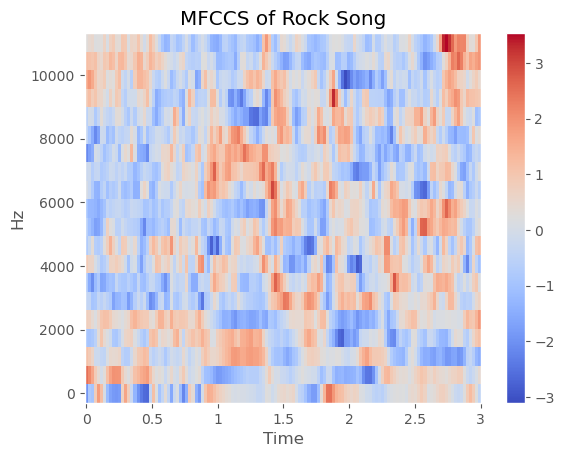

In [66]:
# Scale the MFCCs
mfccs = sklearn.preprocessing.scale(mfccs, axis=1)
mfccs_mean = mfccs.mean()
mfccs_var = mfccs.var()
print(r"The Mean for the Mel-Frequency Cepstral Coefficients are: {val}".format(val = mfccs_mean))
print(r"The Variance for the Mel-Frequency Cepstral Coefficients are: {val}".format(val = mfccs_var))
lib.display.specshow(mfccs, sr=sr, x_axis='time', y_axis = 'hz')
plt.title('MFCCS of Rock Song')
plt.colorbar()
plt.show()

#### Chroma Frequencies
- Entire spectrum is projected onto 12 bins representing the 12 semitones of musical octave
- Chords/Notes into certain Pitch Class (A-G) over time

C:\Users\tmcke\AppData\Local\Temp\ipykernel_2744\2138767856.py:2: FutureWarning: Pass y=[0.07925415 0.05932617 0.03930664 ... 0.03674316 0.05004883 0.13900757] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  chromagram = lib.feature.chroma_stft(x1, sr=sr, hop_length=hop_length)


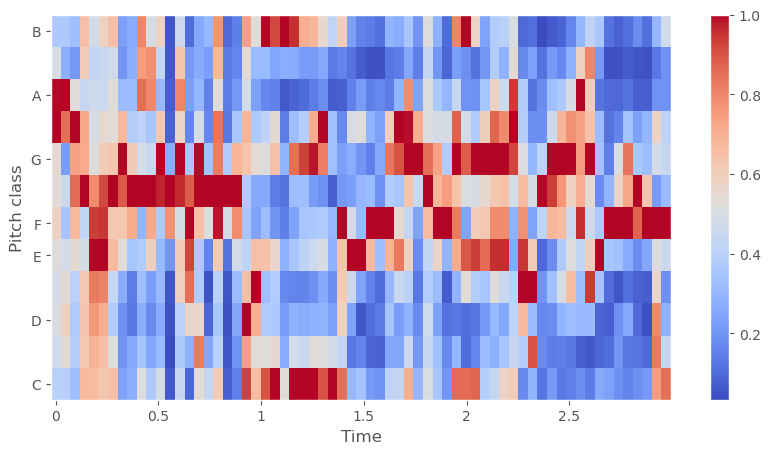

In [65]:
hop_length = 1024
chromagram = lib.feature.chroma_stft(x1, sr=sr, hop_length=hop_length)
plt.figure(figsize=(10, 5))
libdis.specshow(chromagram, x_axis='time', y_axis='chroma', hop_length=hop_length, cmap='coolwarm')
plt.colorbar()
plt.show()

### Jazz Song

In [162]:
seriesJazz, audioPath = SampleRandomSong(df_30sec,"jazz")
x,sr = lib.load(audioPath)
ipy.Audio(audioPath)


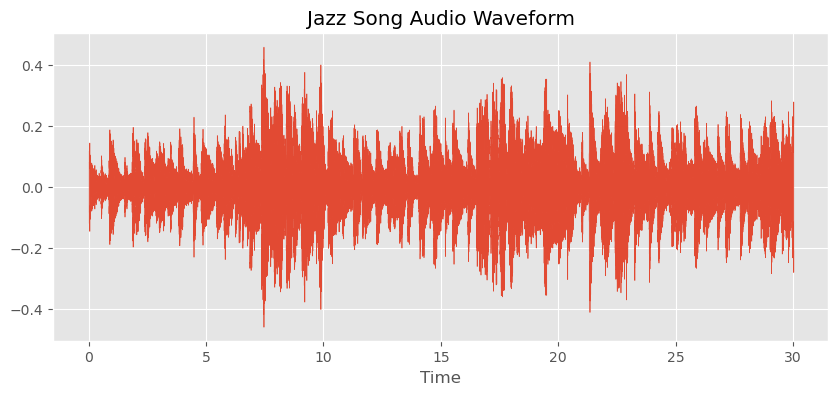

In [163]:
plt.figure(figsize=(10,4))
libdis.waveshow(x,sr=sr)
plt.title('Jazz Song Audio Waveform')
plt.show()

### Classical Song

In [164]:
seriesClassical, audioPath = SampleRandomSong(df_30sec,"classical")
x,sr = lib.load(audioPath)
ipy.Audio(audioPath)

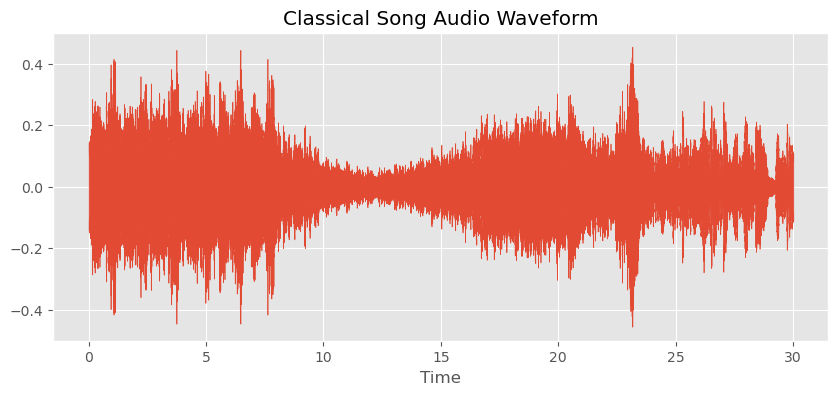

In [165]:
plt.figure(figsize=(10,4))
libdis.waveshow(x,sr=sr)
plt.title('Classical Song Audio Waveform')
plt.show()

### Metal Song

In [157]:
seriesMetal, audioPath = SampleRandomSong(df_30sec,"metal")
x,sr = lib.load(audioPath)
ipy.Audio(audioPath)

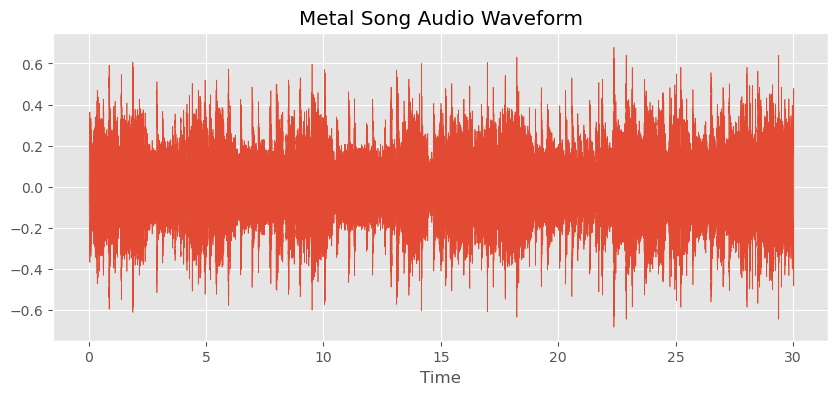

In [158]:
plt.figure(figsize=(10,4))
libdis.waveshow(x,sr=sr)
plt.title('Metal Song Audio Waveform')
plt.show()

### Disco Song

In [6]:
df_disco, audioPath = SampleRandomSong(df_30sec,"disco")
x,sr = lib.load(audioPath)
ipy.Audio(audioPath)

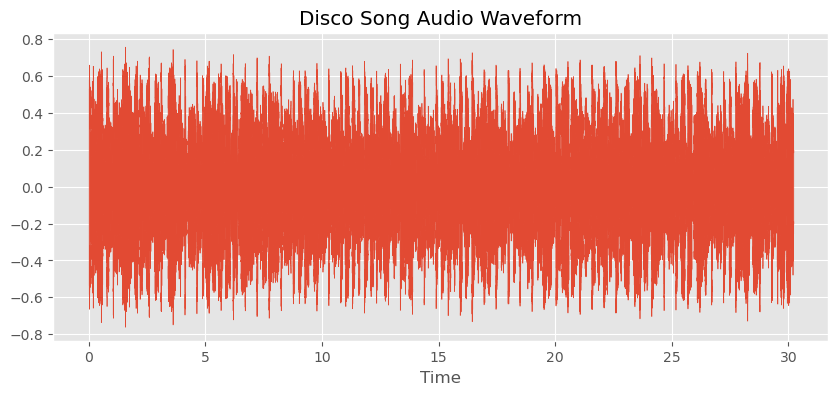

In [7]:
plt.figure(figsize=(10,4))
libdis.waveshow(x,sr=sr)
plt.title('Disco Song Audio Waveform')
plt.show()

#### Fourier Transform of Disco Song

In [27]:
# Default FFT window size
n_fft = 2048 # FFT window size
hop_length = 512 # number audio of frames between STFT columns (looks like a good default)

# Short-time Fourier transform (STFT)
D = np.abs(lib.stft(x, n_fft = n_fft, hop_length = hop_length))

print('Shape of D object:', np.shape(D))

Shape of D object: (1025, 1293)


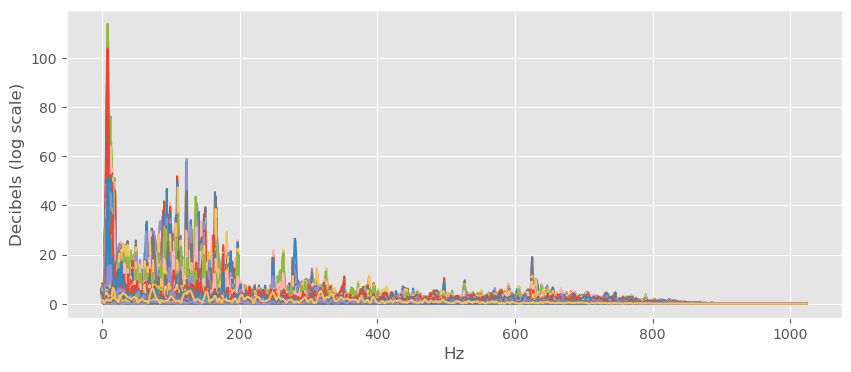

In [28]:
plt.figure(figsize = (10, 4))
plt.plot(D);
plt.xlabel('Hz')
plt.ylabel('Decibels (log scale)')
plt.show()

#### Mel-Spectrogram of Disco Song

C:\Users\tmcke\AppData\Local\Temp\ipykernel_25904\1899063832.py:1: FutureWarning: Pass y=[ 0.03314209  0.00604248  0.03399658 ...  0.04415894 -0.00759888
 -0.03445435] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  X_Mel = lib.feature.melspectrogram(x,sr=sr);


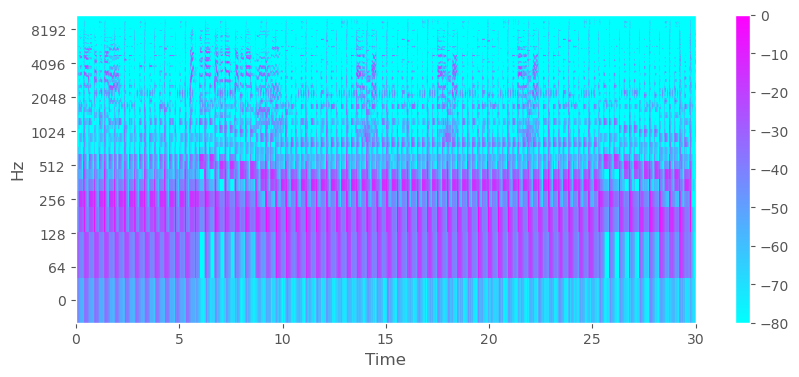

In [63]:
X_Mel = lib.feature.melspectrogram(x,sr=sr)
X_Mel_dB = lib.amplitude_to_db(X_Mel, ref=np.max)
plt.figure(figsize = (10, 4))
libdis.specshow(X_Mel_dB, sr=sr, hop_length=hop_length, x_axis = 'time', y_axis = 'log',cmap = 'cool')
plt.colorbar()
plt.show()

#### Harmonics and Perceptrual of Disco Song
- Harmonics represent the sound color of music
- Perceptrual represents the sound rhythm and emotion

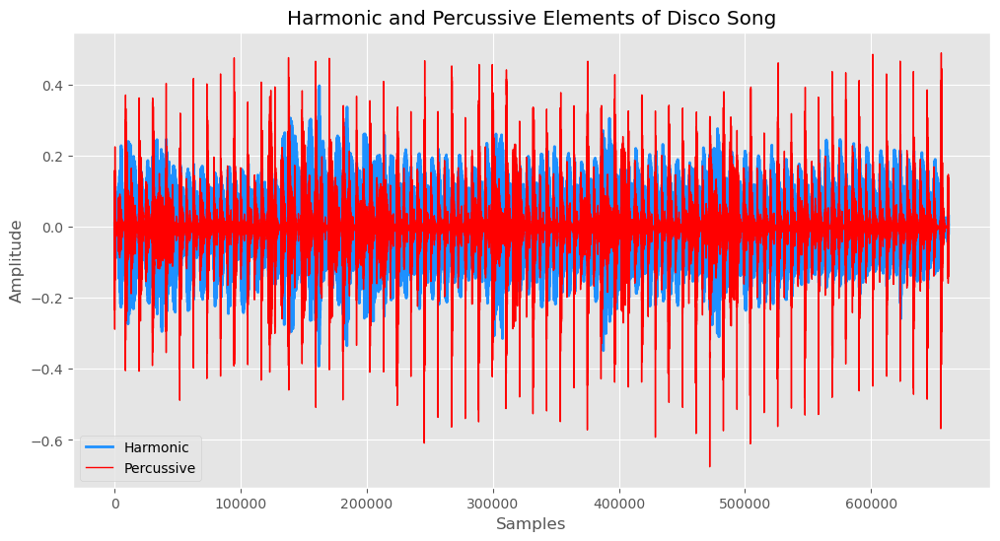

In [41]:
x_harm, x_perc = lib.effects.hpss(x)
plt.figure(figsize = (12, 6))
plt.plot(x_harm, color = 'dodgerblue', linewidth = 2, label = 'Harmonic')
plt.plot(x_perc, color = 'red', linewidth = 1, label = 'Percussive')
plt.xlabel('Samples')
plt.ylabel('Amplitude')
plt.title('Harmonic and Percussive Elements of Disco Song')
plt.legend()
plt.show()

#### Tempo of Disco Song

In [8]:
tempo, _ = lib.beat.beat_track(x, sr=sr)
print('The Tempo for the Disco Song: {val} bpm'.format(val = tempo))

C:\Users\tmcke\AppData\Local\Temp\ipykernel_16744\4117489929.py:1: FutureWarning: Pass y=[-0.18777466 -0.23693848 -0.15542603 ...  0.03741455  0.10574341
  0.09619141] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  tempo, _ = lib.beat.beat_track(x, sr=sr)


The Tempo for the Disco Song: 117.45383522727273 bpm


#### Constant Q-Transform (CQT) of Disco Song
- CQT meaures the energy in each pitch 

c:\Users\tmcke\anaconda3\lib\site-packages\librosa\util\decorators.py:88: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  return f(*args, **kwargs)


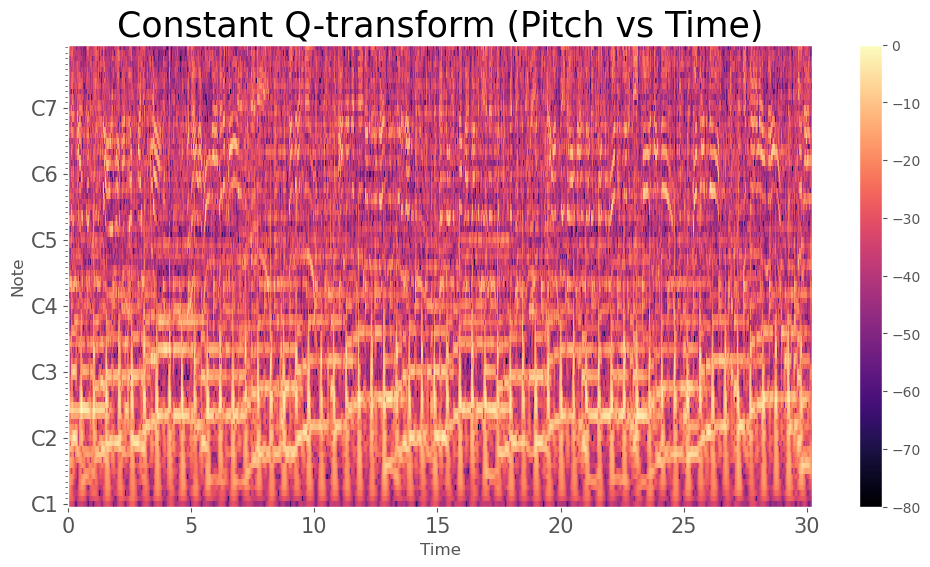

In [48]:
C = lib.cqt(x, sr=sr)
plt.figure(figsize = (12, 6))

# getting the original colormap using cm.get_cmap() function
orig_map=plt.cm.get_cmap('viridis')
  
# reversing the original colormap using reversed() function
rmap = orig_map.reversed()

libdis.specshow(lib.amplitude_to_db(C, ref=np.max),sr=sr, x_axis = 'time', y_axis = 'cqt_note', cmap ='magma')
plt.colorbar()
plt.xticks(fontsize = 15)
plt.yticks(fontsize = 15)
plt.title('Constant Q-transform (Pitch vs Time)', fontsize = 25)
plt.show()

#### Pitch vs Pitch Class using CQT and Chroma
- CQT measures the energy in each pitch
- Chroma measures the energy in each pitch class

c:\Users\tmcke\anaconda3\lib\site-packages\librosa\util\decorators.py:88: UserWarning: Trying to display complex-valued input. Showing magnitude instead.
  return f(*args, **kwargs)


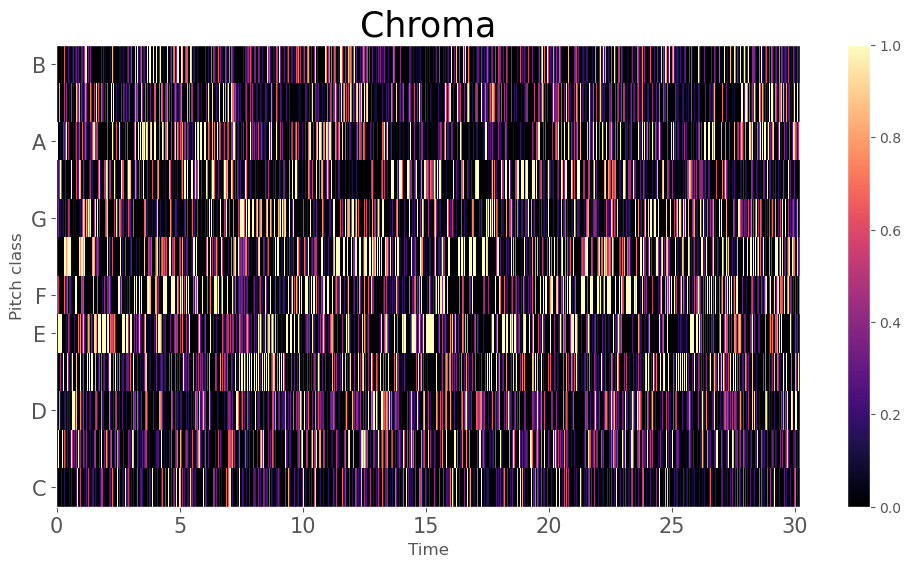

In [45]:
chroma = lib.feature.chroma_cqt(C=C, sr=sr)
plt.figure(figsize = (12, 6))

# getting the original colormap using cm.get_cmap() function
orig_map=plt.cm.get_cmap('magma')
  
# reversing the original colormap using reversed() function
reversed_map = orig_map.reversed()

libdis.specshow(chroma, x_axis = 'time', y_axis = 'chroma', cmap = 'magma')
plt.colorbar()
plt.xticks(fontsize = 15)
plt.yticks(fontsize = 15)
plt.title('Chroma', fontsize = 25)
plt.show()

#### Tonnetz of Disco Song
- representation of projected chroma features onto a 6-dimensional basis representing the perfect fifth, minor third, and major third each as two-dimensional coordinates

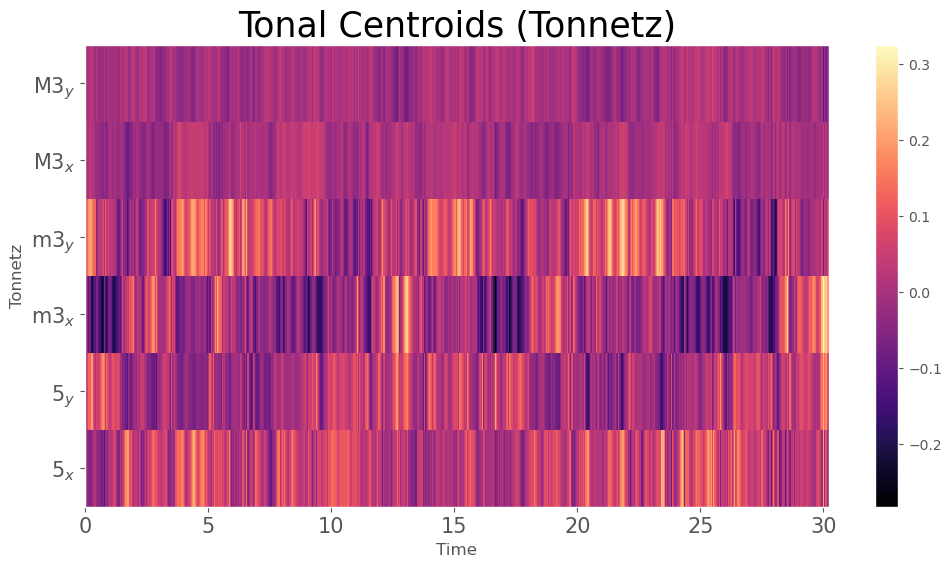

In [44]:
tonnetz = lib.feature.tonnetz(y=x,sr=sr)
plt.figure(figsize = (12, 6))
lib.display.specshow(tonnetz,y_axis='tonnetz', x_axis='time', cmap = 'magma')
plt.colorbar()
plt.xticks(fontsize = 15)
plt.yticks(fontsize = 15)
plt.title('Tonal Centroids (Tonnetz)', fontsize = 25)
plt.show()

### Reggae Song

In [6]:
df_reggae, audioPath = SampleRandomSong(df_30sec,"reggae")
x,sr = lib.load(audioPath)
ipy.Audio(audioPath)

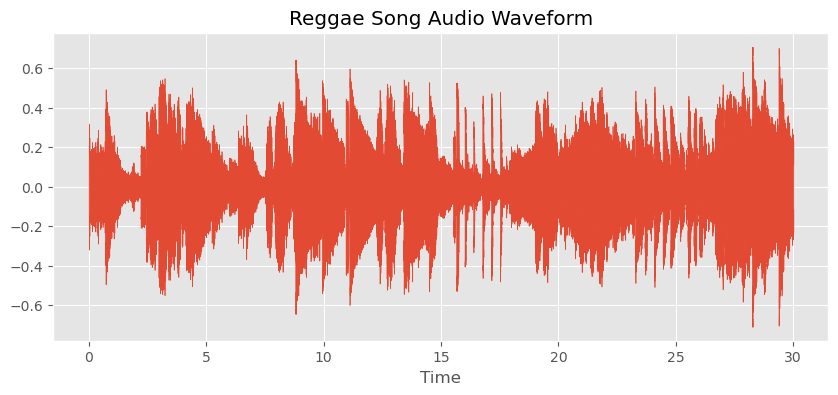

In [175]:
plt.figure(figsize=(10,4))
libdis.waveshow(x,sr=sr)
plt.title('Reggae Song Audio Waveform')
plt.show()

### Blues Song

In [172]:
df_blues, audioPath = SampleRandomSong(df_30sec,"blues")
x,sr = lib.load(audioPath)
ipy.Audio(audioPath)

In [1]:
plt.figure(figsize=(10,4))
libdis.waveshow(x,sr=sr)
plt.title('Blues Song Audio Waveform')
plt.show()

NameError: name 'plt' is not defined

### Country Song

In [170]:
df_country, audioPath = SampleRandomSong(df_30sec,"country")
x,sr = lib.load(audioPath)
ipy.Audio(audioPath)

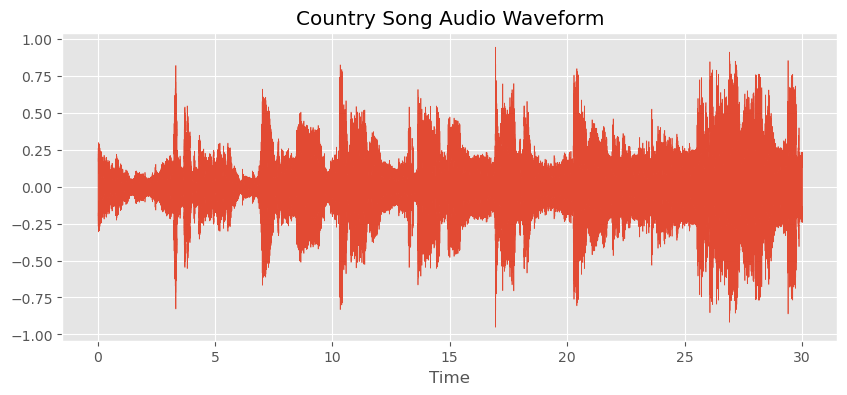

In [171]:
plt.figure(figsize=(10,4))
libdis.waveshow(x,sr=sr)
plt.title('Country Song Audio Waveform')
plt.show()

### Hip-Hop Song

In [190]:
df_hiphop, audioPath = SampleRandomSong(df_30sec,"hiphop")
x,sr = lib.load(audioPath)
ipy.Audio(audioPath)

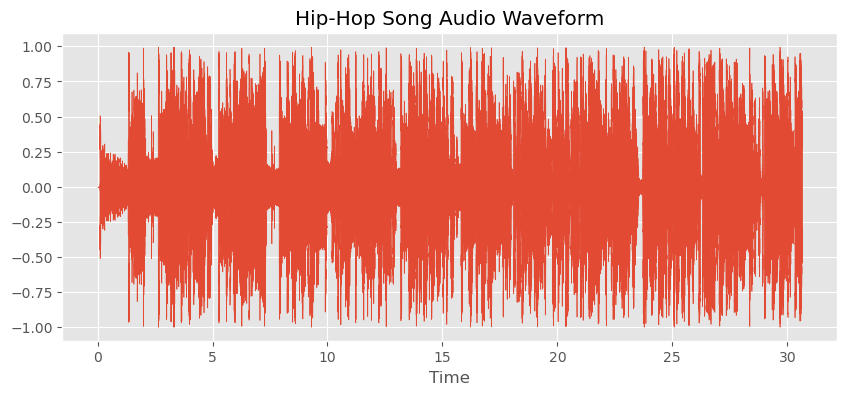

In [169]:
plt.figure(figsize=(10,4))
libdis.waveshow(x,sr=sr)
plt.title('Hip-Hop Song Audio Waveform')
plt.show()

### Pop Song

In [166]:
df_pop, audioPath = SampleRandomSong(df_30sec,"pop")
x,sr = lib.load(audioPath)
ipy.Audio(audioPath)

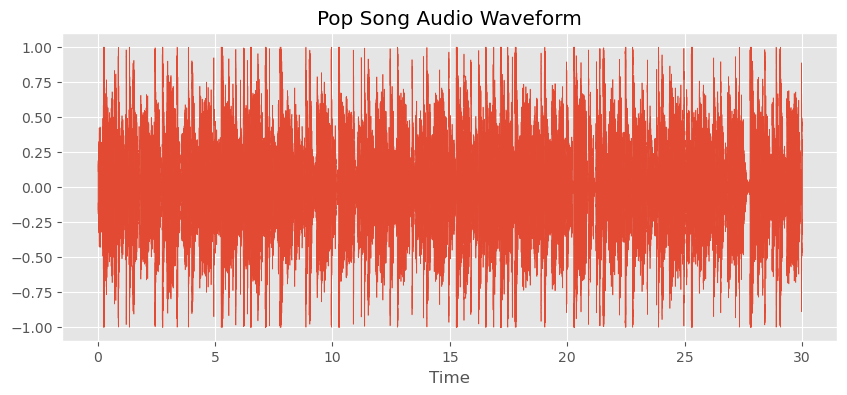

In [167]:
plt.figure(figsize=(10,4))
libdis.waveshow(x,sr=sr)
plt.title('Pop Song Audio Waveform')
plt.show()

## Exploratory Data Analysis
- Primarily going to use the 30 sec features of GTZAN Dataset
- Contains 10 genres with 100 songs each and 60 features

In [ ]:
df = pd.read_csv('features_30_sec.csv')
df

### Boxplot of Genre Distributions

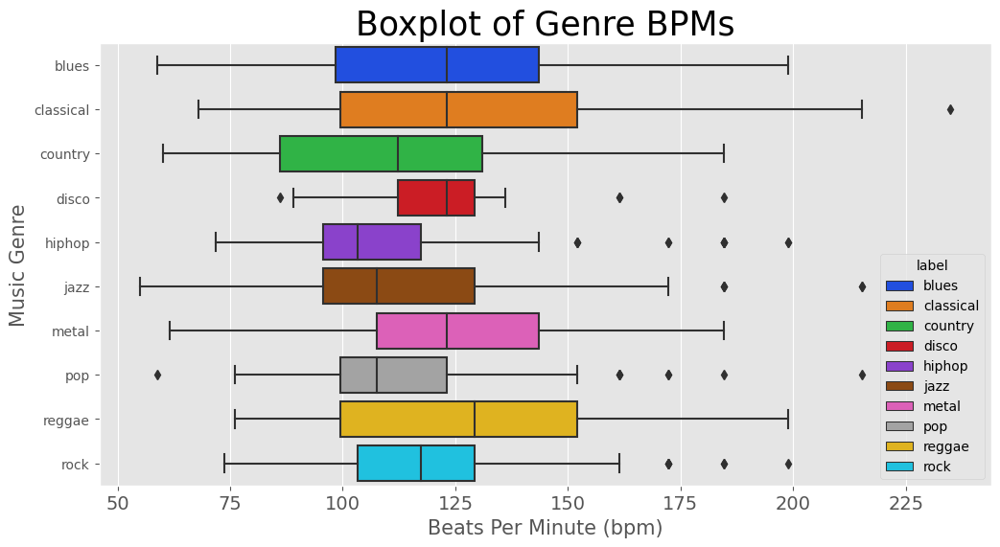

In [24]:
# Extract Tempo and Genre Labels and show distribution of Genre Tempos
tempoData = df[['label','tempo']]

fig, ax = plt.subplots(figsize = (12, 6))
sns.boxplot(x = "tempo", y = "label", data = tempoData, palette = 'bright',hue = 'label',dodge = False);

plt.title('Boxplot of Genre BPMs', fontsize = 25)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 10)
plt.xlabel('Beats Per Minute (bpm)', fontsize = 15)
plt.ylabel('Music Genre', fontsize = 15)
plt.show()


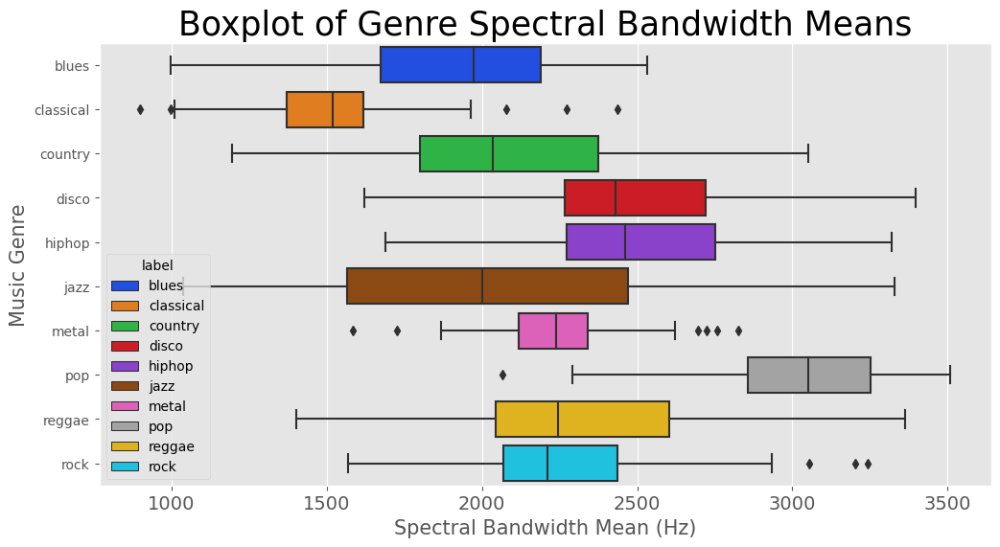

In [43]:
# Extract Tempo and Genre Labels and show distribution of Genre Tempos
BandwidthData = df[['label','spectral_bandwidth_mean']]

fig, ax = plt.subplots(figsize = (12, 6))
sns.boxplot(x = "spectral_bandwidth_mean", y = "label", data = BandwidthData, palette = 'bright',hue = 'label',dodge = False);

plt.title('Boxplot of Genre Spectral Bandwidth Means', fontsize = 25)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 10)
plt.xlabel('Spectral Bandwidth Mean (Hz)', fontsize = 15)
plt.ylabel('Music Genre', fontsize = 15)
plt.show()

### Principal Component Analysis & K-Means Clustering

### Principal Component Analysis 
1. Normalization
2. Extract Principal Components
3. Visualization

In [221]:
# Read CSV file of 10 genres of Music
#df = pd.read_csv('features_3_sec.csv')
df = pd.read_csv('features_30_sec.csv')
# Use PCA to reduce dimensionality
X = df.drop(['filename','length','label'], axis=1)
y = df['label']

# Normalize 
cols = X.columns
scaler = preprocessing.MinMaxScaler()
np_scaled = scaler.fit_transform(X)
X = pd.DataFrame(np_scaled, columns = cols)

# PCA - 2 Components
pca = PCA(n_components=2)
components = pca.fit_transform(X)
temp_df = pd.DataFrame(data = components, columns = ['Principal Component 1', 'Principal Component 2'])
print(pca.explained_variance_ratio_)

# Concatenate with target label
OG_PCA_df = pd.concat([temp_df, y], axis=1)
#pca.explained_variance_ratio_
OG_PCA_df

[0.24644968 0.22028192]


,Principal Component 1,Principal Component 2,label
0,-0.394212,-0.116145,blues
1,0.052019,-0.270757,blues
2,-0.479184,-0.224616,blues
3,0.017145,-0.439886,blues
4,-0.160395,-0.508617,blues
...,...,...,...
995,-0.754452,-0.039476,rock
996,-0.810739,-0.031233,rock
997,-0.845324,-0.007202,rock
998,-0.234262,-0.372666,rock


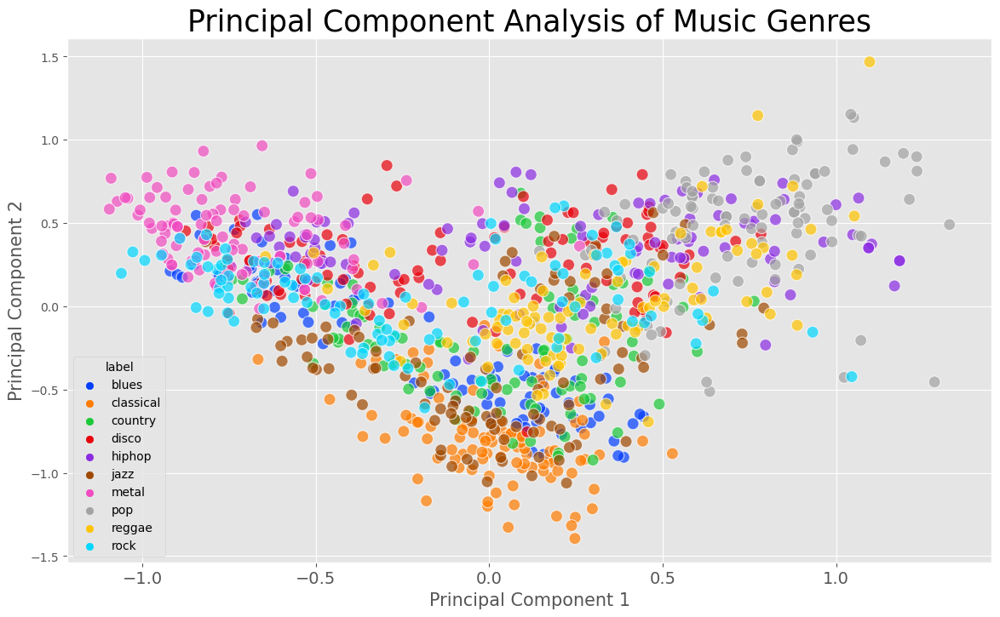

In [222]:
# Visualize the Principal Components of GTZAN Dataset
plt.figure(figsize = (14, 8))
sns.scatterplot(x = "Principal Component 1",
                y = "Principal Component 2",
                data = OG_PCA_df,
                hue = "label",
                palette = 'bright',
                alpha = 0.7,
                s = 100);
plt.title('Principal Component Analysis of Music Genres', fontsize = 25)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 10)
plt.xlabel('Principal Component 1', fontsize = 15)
plt.ylabel('Principal Component 2', fontsize = 15)
plt.grid(True)
plt.show()

### K-Means Clustering

In [ ]:
# Read CSV file of 10 genres of Music
#df = pd.read_csv('features_3_sec.csv')
df = pd.read_csv('features_30_sec.csv')
# Use PCA to reduce dimensionality
X = df.drop(['filename','length','label'], axis=1)
y = df['label']

# Normalize 
cols = X.columns
scaler = preprocessing.MinMaxScaler()
X = scaler.fit_transform(X)

# PCA - 2 Components
pca = PCA()
pca.fit(X)
print(pca.explained_variance_ratio_)

The Number of Components estimated to preserve 80% of Variance = 10


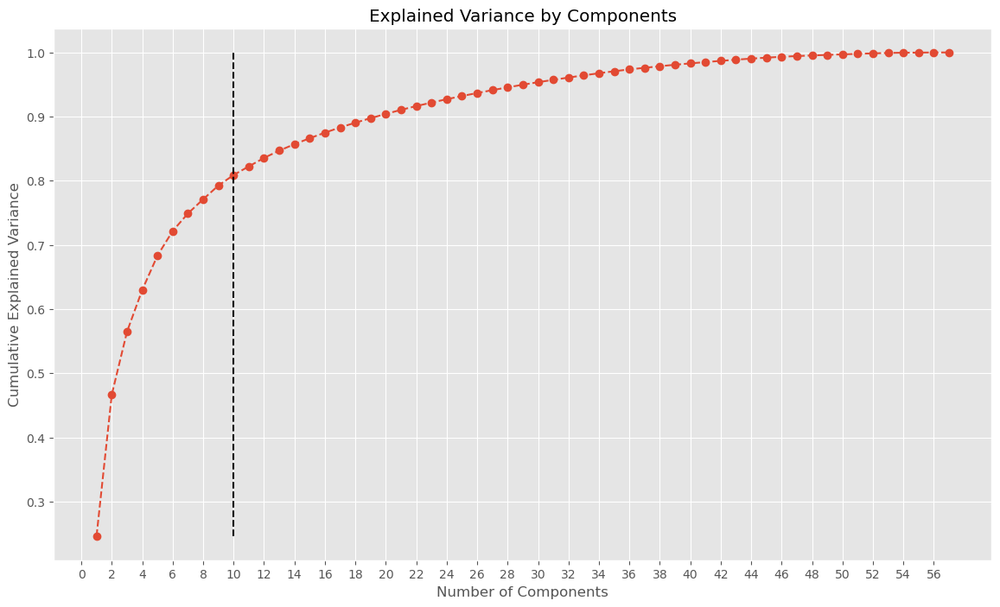

In [4]:
# Decide how many features to keep based on Cumulative Variance plot
a = range(1,len(pca.explained_variance_ratio_)+1)
b = pca.explained_variance_ratio_.cumsum() >= 0.8
c = np.sum(b == False)
n_components = a[c]
print(f"The Number of Components estimated to preserve 80% of Variance = {n_components}")
plt.figure(figsize=(14,8))
plt.plot(a, pca.explained_variance_ratio_.cumsum(), marker = 'o', linestyle = '--')
plt.vlines(a[c], ymin=np.min(pca.explained_variance_ratio_.cumsum()), ymax=np.max(pca.explained_variance_ratio_.cumsum()), color = 'k', linestyles='dashed')
plt.xticks(range(0,len(pca.explained_variance_ratio_),2))
plt.title('Explained Variance by Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.show()

In [5]:
# Reduce dimensionality using PCA from n = 57 to value calculated above that preserves 80% of variance
pca = PCA(n_components=n_components)
pca.fit(X)
scores_pca = pca.transform(X)

In [6]:
from kneed import KneeLocator
# Determine how many clustering solutions to test
wcss = []
max_clusters = 21
for i in range(1,max_clusters):
    kmeans_pca = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    kmeans_pca.fit(scores_pca)
    wcss.append(kmeans_pca.inertia_)
    
# programmatically locate the elbow
n_clusters = KneeLocator([i for i in range(1, max_clusters)], wcss, curve='convex', direction='decreasing').knee
print("Optimal number of clusters =", n_clusters)

Optimal number of clusters = 5


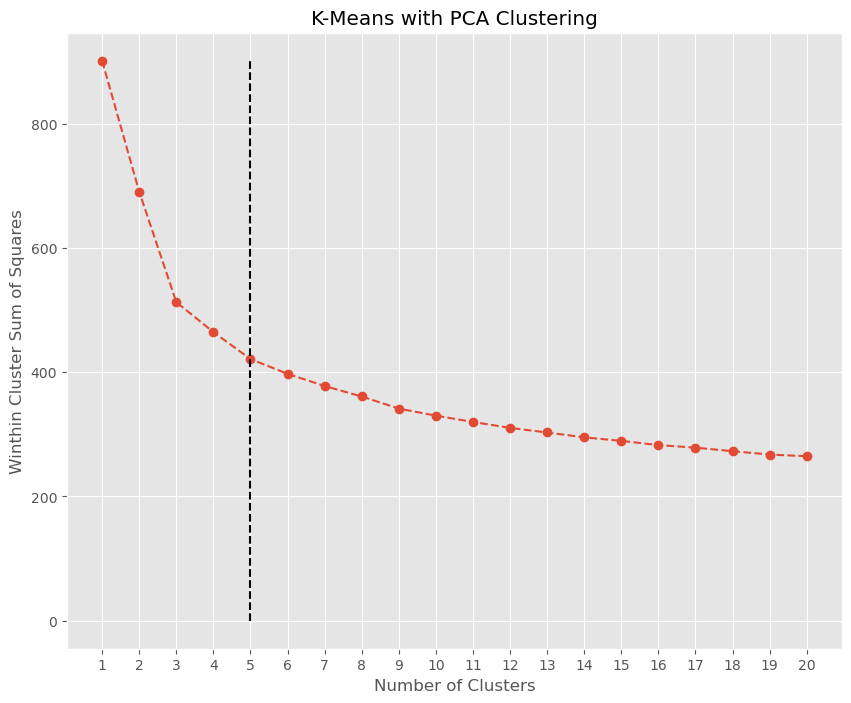

In [7]:
# Plot WCSS against the number of components on graph
plt.figure(figsize=(10,8))
plt.plot(range(1,21), wcss, marker = 'o', linestyle = '--')
plt.vlines(n_clusters, ymin=0, ymax=max(wcss), color = 'k', linestyles='dashed')
plt.title('K-Means with PCA Clustering')
plt.xlabel('Number of Clusters')
plt.xticks(range(1,max_clusters))
plt.ylabel('Winthin Cluster Sum of Squares')
plt.show()

In [ ]:
kmeans_pca = KMeans(n_clusters = n_clusters, init = 'k-means++', random_state = 42)
kmeans_pca.fit(scores_pca)
df['Cluster'] = kmeans_pca.labels_
df

In [9]:
genres = df['Cluster']
X = df.loc[:,df.columns != 'label']
# PCA - 2 Components
pca = PCA(n_components=2)
components = pca.fit_transform(scores_pca)
temp_df = pd.DataFrame(data = components, columns = ['Principal Component 1', 'Principal Component 2'])

# Concatenate with target label
PCA_df = pd.concat([temp_df, genres], axis=1)
#pca.explained_variance_ratio_
PCA_df

,Principal Component 1,Principal Component 2,Cluster
0,-0.394212,-0.116145,0
1,0.052019,-0.270757,3
2,-0.479184,-0.224616,0
3,0.017145,-0.439886,4
4,-0.160395,-0.508617,4
...,...,...,...
995,-0.754452,-0.039476,0
996,-0.810739,-0.031233,0
997,-0.845324,-0.007202,0
998,-0.234262,-0.372666,3


In [ ]:
# Visualize the Principal Components of GTZAN Dataset
plt.figure(figsize = (12, 8))
sns.scatterplot(x = "Principal Component 1",y = "Principal Component 2",data = OG_PCA_df,hue = "label",palette = 'bright',alpha = 0.8,s = 100);
plt.title('Principal Component Analysis of Music Genres', fontsize = 22)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 10)
plt.xlabel('Principal Component 1', fontsize = 15)
plt.ylabel('Principal Component 2', fontsize = 15)
plt.grid(True)
plt.show()

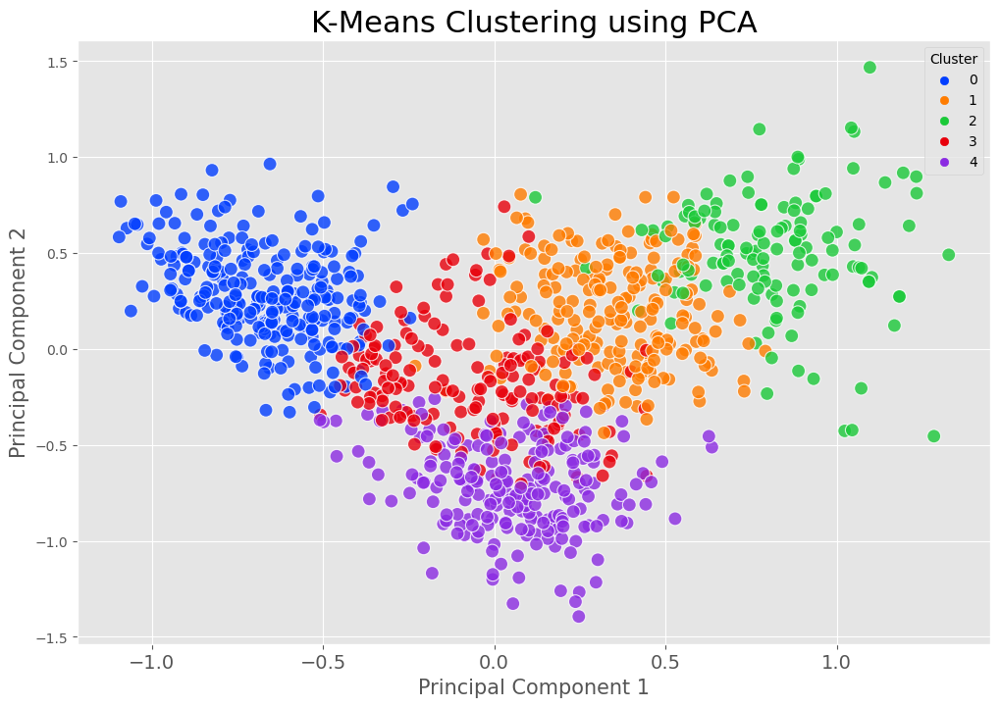

In [11]:
# Visualize the Principal Components of GTZAN Dataset
plt.figure(figsize = (12, 8))
sns.scatterplot(x = "Principal Component 1",y = "Principal Component 2",data = PCA_df,hue = "Cluster",palette = 'bright',alpha = 0.8,s = 100);
plt.title('K-Means Clustering using PCA', fontsize = 22)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 10)
plt.xlabel('Principal Component 1', fontsize = 15)
plt.ylabel('Principal Component 2', fontsize = 15)
plt.grid(True)
plt.show()

## Classification of Music Genres

### Convert Genre Labels into Numerical Values from 0 - 9 for all 10 Genres

In [4]:
# Read CSV file of 10 genres of Music
#df = pd.read_csv('features_3_sec.csv')
df = pd.read_csv('features_30_sec.csv')

In [11]:
df['label'] = df['label'].replace('blues',0)
df['label'] = df['label'].replace('classical',1)
df['label'] = df['label'].replace('country',2)
df['label'] = df['label'].replace('disco',3)
df['label'] = df['label'].replace('hiphop',4)
df['label'] = df['label'].replace('jazz',5)
df['label'] = df['label'].replace('metal',6)
df['label'] = df['label'].replace('pop',7)
df['label'] = df['label'].replace('reggae',8)
df['label'] = df['label'].replace('rock',9)

### Normalize Columns of Dataframe

In [ ]:
# Remove irrelevant columns and parse target column from dataset
X = df.drop(['filename','length','label'], axis=1)
y = df['label']

# Normalize so everything is on the same scale. 
cols = X.columns
scaler = preprocessing.MinMaxScaler()
np_scaled = scaler.fit_transform(X)

# new data frame with the new scaled data. 
X = pd.DataFrame(np_scaled, columns = cols)
X

### Split Dataframe into Training-Test Sets 

In [13]:
# Specify Ratio of Training/Testing and Split into separate sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Specify number of K-Folds when performing Cross-Validation
k = 10

# Create an instance of StratifiedKFold which can be used to get indices of different training and test folds
skfold = StratifiedKFold(n_splits=k)
kfold = KFold(n_splits=k, shuffle=True)
scores = []

### Perform K-Fold Cross Validation using Different Classifier Models

### Naive Bayes Model

Cross Validation accuracy scores: [0.49333333 0.46666667 0.57333333 0.53333333 0.50666667 0.62666667
 0.64       0.49333333 0.50666667 0.49333333]
Cross Validation accuracy: 0.533 +/- 0.057
K-fold CV average score: 0.52 with K = 10
Stratified K-fold CV average score: 0.53
Accuracy Naive Bayes : 0.512 



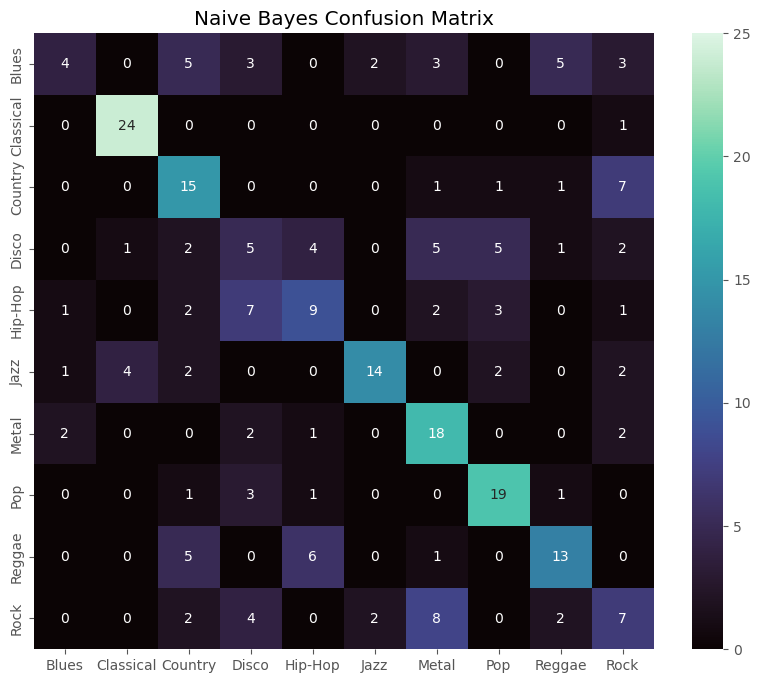

In [29]:
# Naive Bayes Model
nb = GaussianNB()

# Create an instance of Pipeline
pipeline = make_pipeline(MinMaxScaler(), nb)

# Compute Cross-Validation Scores and Print the Average Accuracy Score
scores = cross_val_score(pipeline, X=X_train, y=y_train, cv=k, n_jobs=1)

# Print Accuracy Scores from K-Fold Cross Validation
print('Cross Validation accuracy scores: %s' % scores)
print('Cross Validation accuracy: %.3f +/- %.3f' % (np.mean(scores),np.std(scores)))

# use KFold CV and print mean accuracy scores
kf_cv_scores = cross_val_score(nb,X_train,y_train,cv=kfold)
skf_cv_scores = cross_val_score(nb,X_train,y_train,cv=skfold)
print(f"K-fold CV average score: %.2f with K = {k}" % kf_cv_scores.mean())
print(f"Stratified K-fold CV average score: %.2f" % skf_cv_scores.mean())

# Predict using Model and Plot the Confusion Matrix
nb.fit(X_train,y_train)
y_pred = nb.predict(X_test)

# Naive Bayes
model_assess(nb, X_train, y_train, X_test, y_test, "Naive Bayes")
plt.figure(figsize = (10,8))
sns.heatmap(confusion_matrix(y_test,y_pred),annot=True,  cmap = 'mako',
            xticklabels = ['Blues','Classical','Country','Disco','Hip-Hop','Jazz','Metal','Pop','Reggae','Rock'],
            yticklabels = ['Blues','Classical','Country','Disco','Hip-Hop','Jazz','Metal','Pop','Reggae','Rock'],
            vmin = 0, vmax = len(y_test)/10)
plt.title('Naive Bayes Confusion Matrix')
plt.show()


### Decision Tree Model

Cross Validation accuracy scores: [0.45333333 0.57333333 0.49333333 0.61333333 0.53333333 0.48
 0.53333333 0.57333333 0.42666667 0.57333333]
Cross Validation accuracy: 0.525 +/- 0.057
K-fold CV average score: 0.51 with K = 10
Stratified K-fold CV average score: 0.53
Accuracy Decision Tree : 0.516 



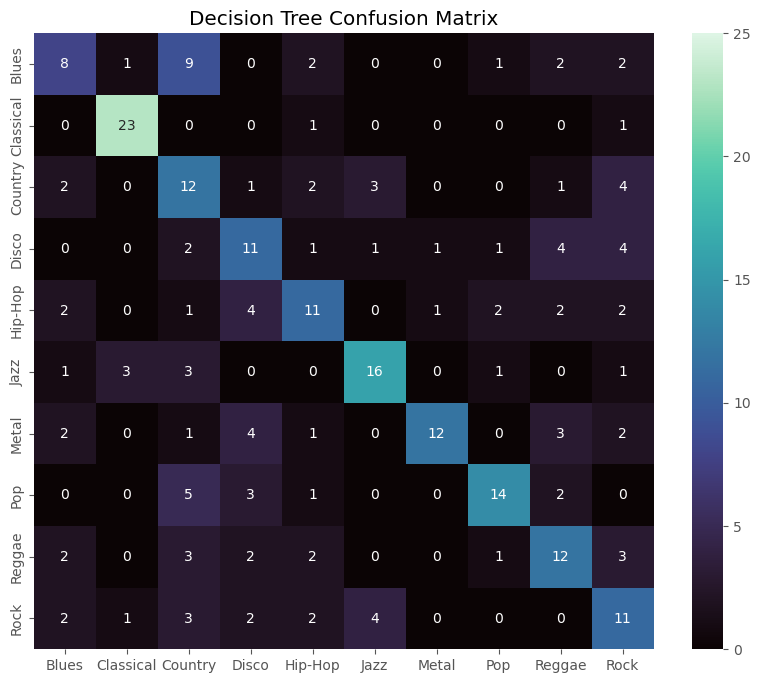

In [28]:
# Decision Tree Model
dt = DecisionTreeClassifier(criterion = 'entropy')

# Create an instance of Pipeline
pipeline = make_pipeline(MinMaxScaler(), dt)

# Compute Cross-Validation Scores and Print the Average Accuracy Score
scores = cross_val_score(pipeline, X=X_train, y=y_train, cv=k, n_jobs=1)

# Print Accuracy Scores from K-Fold Cross Validation
print('Cross Validation accuracy scores: %s' % scores)
print('Cross Validation accuracy: %.3f +/- %.3f' % (np.mean(scores),np.std(scores)))

# use KFold CV and print mean accuracy scores
kf_cv_scores = cross_val_score(dt,X_train,y_train,cv=kfold)
skf_cv_scores = cross_val_score(dt,X_train,y_train,cv=skfold)
print(f"K-fold CV average score: %.2f with K = {k}" % kf_cv_scores.mean())
print(f"Stratified K-fold CV average score: %.2f" % skf_cv_scores.mean())

# Predict using Model and Plot the Confusion Matrix
dt.fit(X_train,y_train)
y_pred = dt.predict(X_test)

# Decision Tree
model_assess(dt,X_train, y_train, X_test, y_test, "Decision Tree")
plt.figure(figsize = (10,8))
sns.heatmap(confusion_matrix(y_test,y_pred),annot=True,  cmap = 'mako',
            xticklabels = ['Blues','Classical','Country','Disco','Hip-Hop','Jazz','Metal','Pop','Reggae','Rock'],
            yticklabels = ['Blues','Classical','Country','Disco','Hip-Hop','Jazz','Metal','Pop','Reggae','Rock'],
            vmin = 0, vmax = len(y_test)/10)
plt.title('Decision Tree Confusion Matrix')
plt.show()

### Random Forest Model

Cross Validation accuracy scores: [0.66666667 0.68       0.74666667 0.70666667 0.66666667 0.68
 0.74666667 0.61333333 0.69333333 0.69333333]
Cross Validation accuracy: 0.689 +/- 0.037
K-fold CV average score: 0.68 with K = 10
Stratified K-fold CV average score: 0.69
Accuracy Random Forest : 0.708 



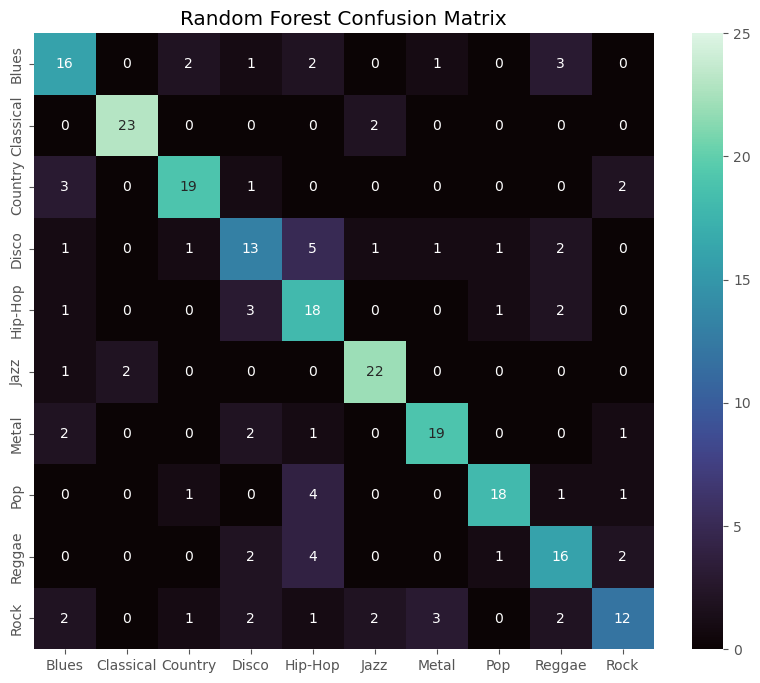

In [27]:
# Decision Tree Model
rf = RandomForestClassifier(criterion = 'entropy')

# Create an instance of Pipeline
pipeline = make_pipeline(MinMaxScaler(), rf)

# Compute Cross-Validation Scores and Print the Average Accuracy Score
scores = cross_val_score(pipeline, X=X_train, y=y_train, cv=k, n_jobs=1)

# Print Accuracy Scores from K-Fold Cross Validation
print('Cross Validation accuracy scores: %s' % scores)
print('Cross Validation accuracy: %.3f +/- %.3f' % (np.mean(scores),np.std(scores)))

# use KFold CV and print mean accuracy scores
kf_cv_scores = cross_val_score(rf,X_train,y_train,cv=kfold)
skf_cv_scores = cross_val_score(rf,X_train,y_train,cv=skfold)
print(f"K-fold CV average score: %.2f with K = {k}" % kf_cv_scores.mean())
print(f"Stratified K-fold CV average score: %.2f" % skf_cv_scores.mean())

# Predict using Model and Plot the Confusion Matrix
rf.fit(X_train,y_train)
y_pred = rf.predict(X_test)

# Random Forest
model_assess(rf, X_train, y_train, X_test, y_test, "Random Forest")
plt.figure(figsize = (10,8))
sns.heatmap(confusion_matrix(y_test,y_pred),annot=True,  cmap = 'mako',
            xticklabels = ['Blues','Classical','Country','Disco','Hip-Hop','Jazz','Metal','Pop','Reggae','Rock'],
            yticklabels = ['Blues','Classical','Country','Disco','Hip-Hop','Jazz','Metal','Pop','Reggae','Rock'],
            vmin = 0, vmax = len(y_test)/10)
plt.title('Random Forest Confusion Matrix')
plt.show()

### Logistic Regression Model

Cross Validation accuracy scores: [0.6        0.6        0.64       0.77333333 0.70666667 0.73333333
 0.68       0.62666667 0.66666667 0.61333333]
Cross Validation accuracy: 0.664 +/- 0.056
K-fold CV average score: 0.64 with K = 10
Stratified K-fold CV average score: 0.65
Accuracy Logistic Regression : 0.664 



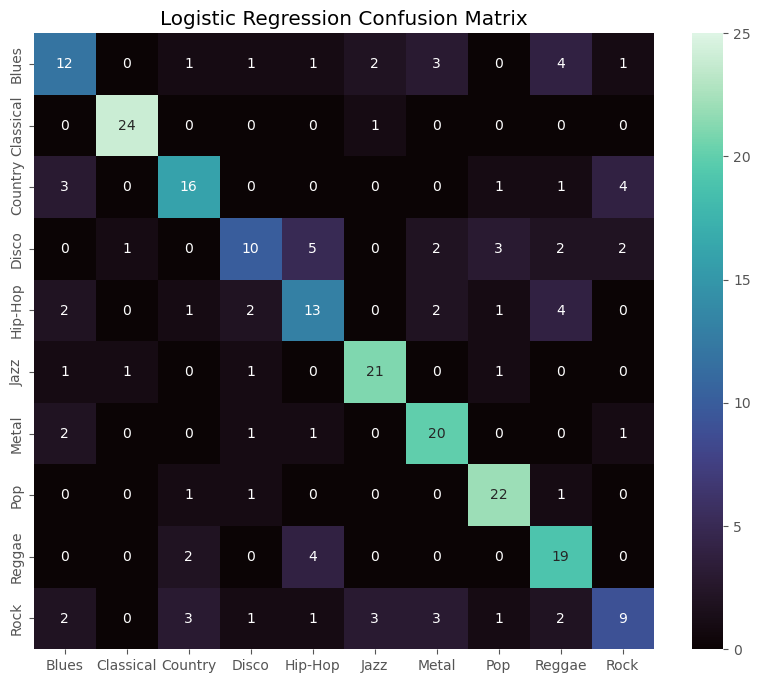

In [26]:
# Logistic Regression Model
lrg = LogisticRegression(random_state=42, multi_class='auto',max_iter=500)

# Create an instance of Pipeline
pipeline = make_pipeline(MinMaxScaler(), lrg)

# Compute Cross-Validation Scores and Print the Average Accuracy Score
scores = cross_val_score(pipeline, X=X_train, y=y_train, cv=k, n_jobs=1)

# Print Accuracy Scores from K-Fold Cross Validation
print('Cross Validation accuracy scores: %s' % scores)
print('Cross Validation accuracy: %.3f +/- %.3f' % (np.mean(scores),np.std(scores)))

# use KFold CV and print mean accuracy scores
kf_cv_scores = cross_val_score(lrg,X_train,y_train,cv=kfold)
skf_cv_scores = cross_val_score(lrg,X_train,y_train,cv=skfold)
print(f"K-fold CV average score: %.2f with K = {k}" % kf_cv_scores.mean())
print(f"Stratified K-fold CV average score: %.2f" % skf_cv_scores.mean())

# Predict using Model and Plot the Confusion Matrix
lrg.fit(X_train,y_train)
y_pred = lrg.predict(X_test)

# Logistic Regression
model_assess(lrg, X_train, y_train, X_test, y_test, "Logistic Regression")
plt.figure(figsize = (10,8))
sns.heatmap(confusion_matrix(y_test,y_pred),annot=True,  cmap = 'mako',
            xticklabels = ['Blues','Classical','Country','Disco','Hip-Hop','Jazz','Metal','Pop','Reggae','Rock'],
            yticklabels = ['Blues','Classical','Country','Disco','Hip-Hop','Jazz','Metal','Pop','Reggae','Rock'],
            vmin = 0, vmax = len(y_test)/10)
plt.title('Logistic Regression Confusion Matrix')
plt.show()

### K-Nearest Neighbors Model

Cross Validation accuracy scores: [0.675  0.75   0.7    0.6625 0.725  0.775  0.6    0.65   0.6375 0.7   ]
Cross Validation accuracy: 0.688 +/- 0.051
K-fold CV average score: 0.70 with K = 10
Stratified K-fold CV average score: 0.70
Accuracy KNN : 0.735 



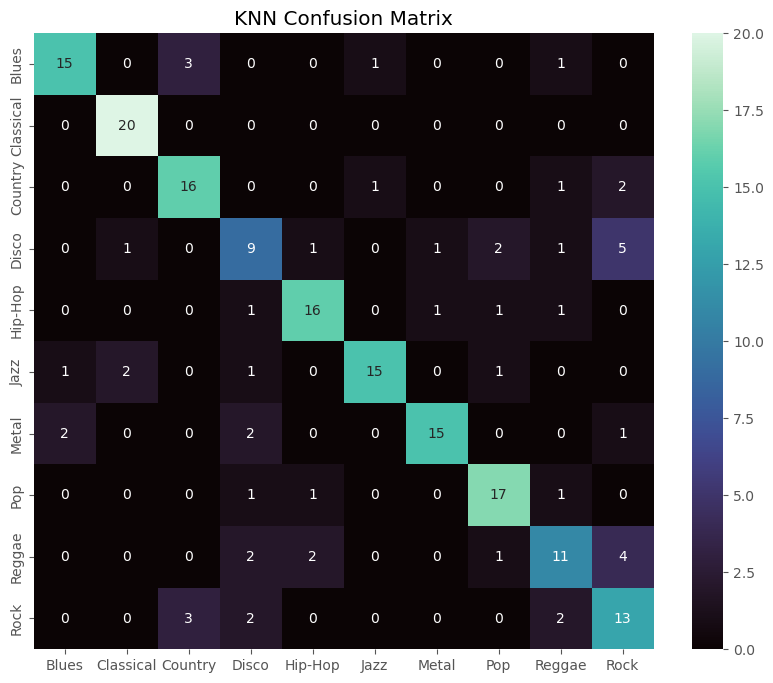

In [14]:
# K-Nearest Neighbor Model
knn = KNeighborsClassifier(weights = 'distance')

# Create an instance of Pipeline
pipeline = make_pipeline(MinMaxScaler(), knn)

# Compute Cross-Validation Scores and Print the Average Accuracy Score
scores = cross_val_score(pipeline, X=X_train, y=y_train, cv=k, n_jobs=1)

# Print Accuracy Scores from K-Fold Cross Validation
print('Cross Validation accuracy scores: %s' % scores)
print('Cross Validation accuracy: %.3f +/- %.3f' % (np.mean(scores),np.std(scores)))

# use KFold CV and print mean accuracy scores
kf_cv_scores = cross_val_score(knn,X_train,y_train,cv=kfold)
skf_cv_scores = cross_val_score(knn,X_train,y_train,cv=skfold)
print(f"K-fold CV average score: %.2f with K = {k}" % kf_cv_scores.mean())
print(f"Stratified K-fold CV average score: %.2f" % skf_cv_scores.mean())

# Predict using Model and Plot the Confusion Matrix
knn.fit(X_train,y_train)
y_pred = knn.predict(X_test)

# KNN
model_assess(knn, X_train, y_train, X_test, y_test, "KNN")
plt.figure(figsize = (10,8))
sns.heatmap(confusion_matrix(y_test,y_pred),annot=True,  cmap = 'mako',
            xticklabels = ['Blues','Classical','Country','Disco','Hip-Hop','Jazz','Metal','Pop','Reggae','Rock'],
            yticklabels = ['Blues','Classical','Country','Disco','Hip-Hop','Jazz','Metal','Pop','Reggae','Rock'],
            vmin = 0, vmax = len(y_test)/10)
plt.title('KNN Confusion Matrix')
plt.show()

### Support Vector Machine Model

Cross Validation accuracy scores: [0.66666667 0.66666667 0.66666667 0.84       0.72       0.69333333
 0.73333333 0.68       0.69333333 0.68      ]
Cross Validation accuracy: 0.704 +/- 0.050
K-fold CV average score: 0.70 with K = 10
Stratified K-fold CV average score: 0.70
Accuracy Support Vector Machine : 0.688 



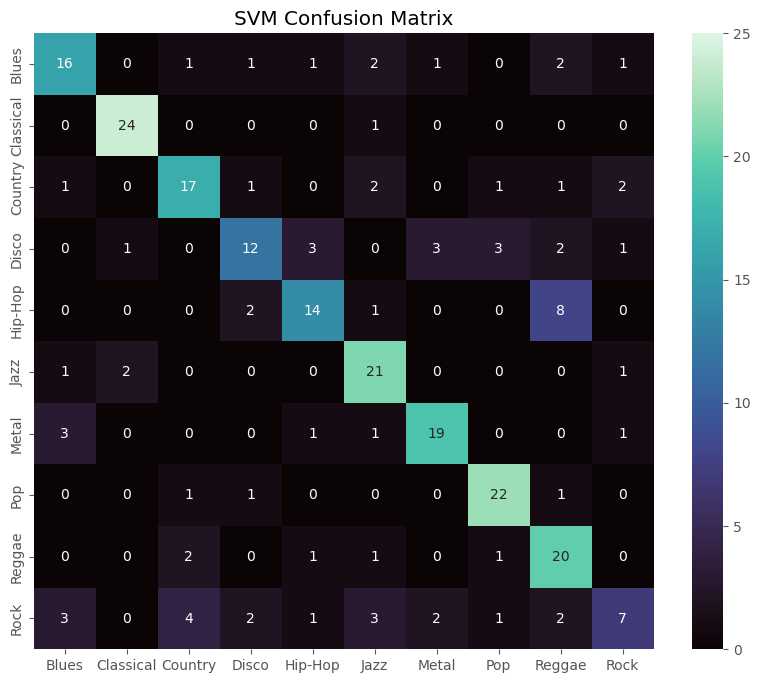

In [34]:
# Support Vector Machine Model
#svm = SVC(kernel = 'poly', decision_function_shape="ovr")
svm = LinearSVC(random_state = 42)

# Create an instance of Pipeline
pipeline = make_pipeline(MinMaxScaler(), svm)

# Compute Cross-Validation Scores and Print the Average Accuracy Score
scores = cross_val_score(pipeline, X=X_train, y=y_train, cv=k, n_jobs=1)

# Print Accuracy Scores from K-Fold Cross Validation
print('Cross Validation accuracy scores: %s' % scores)
print('Cross Validation accuracy: %.3f +/- %.3f' % (np.mean(scores),np.std(scores)))

# use KFold CV and print mean accuracy scores
kf_cv_scores = cross_val_score(svm,X_train,y_train,cv=kfold)
skf_cv_scores = cross_val_score(svm,X_train,y_train,cv=skfold)
print(f"K-fold CV average score: %.2f with K = {k}" % kf_cv_scores.mean())
print(f"Stratified K-fold CV average score: %.2f" % skf_cv_scores.mean())

# Predict using Model and Plot the Confusion Matrix
svm.fit(X_train,y_train)
y_pred = svm.predict(X_test)

# Support Vector Machine
model_assess(svm, X_train, y_train, X_test, y_test, "Support Vector Machine")
plt.figure(figsize = (10,8))
sns.heatmap(confusion_matrix(y_test,y_pred),annot=True,  cmap = 'mako',
            xticklabels = ['Blues','Classical','Country','Disco','Hip-Hop','Jazz','Metal','Pop','Reggae','Rock'],
            yticklabels = ['Blues','Classical','Country','Disco','Hip-Hop','Jazz','Metal','Pop','Reggae','Rock'],
            vmin = 0, vmax = len(y_test)/10)
plt.title('SVM Confusion Matrix')
plt.show()

### Cross Gradient Boost Model

Cross Validation accuracy scores: [0.66666667 0.69333333 0.69333333 0.74666667 0.66666667 0.77333333
 0.73333333 0.74666667 0.68       0.74666667]
Cross Validation accuracy: 0.715 +/- 0.037
K-fold CV average score: 0.71 with K = 10
Stratified K-fold CV average score: 0.71
Accuracy Cross Gradient Booster : 0.744 



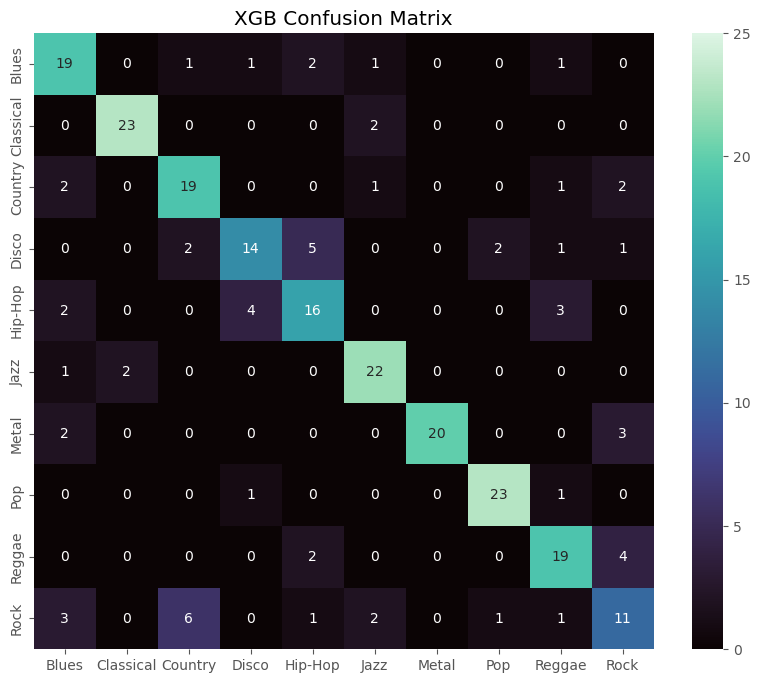

In [23]:
# Cross Gradient Booster
xgb = XGBClassifier()

# Create an instance of Pipeline
pipeline = make_pipeline(MinMaxScaler(), xgb)

# Compute Cross-Validation Scores and Print the Average Accuracy Score
scores = cross_val_score(pipeline, X=X_train, y=y_train, cv=k, n_jobs=1)

# Print Accuracy Scores from K-Fold Cross Validation
print('Cross Validation accuracy scores: %s' % scores)
print('Cross Validation accuracy: %.3f +/- %.3f' % (np.mean(scores),np.std(scores)))

# use KFold CV and print mean accuracy scores
kf_cv_scores = cross_val_score(xgb,X_train,y_train,cv=kfold)
skf_cv_scores = cross_val_score(xgb,X_train,y_train,cv=skfold)
print(f"K-fold CV average score: %.2f with K = {k}" % kf_cv_scores.mean())
print(f"Stratified K-fold CV average score: %.2f" % skf_cv_scores.mean())

# Predict using Model and Plot the Confusion Matrix
xgb.fit(X_train,y_train)
y_pred = xgb.predict(X_test)

# Cross Gradient Booster
model_assess(xgb, X_train, y_train, X_test, y_test, "Cross Gradient Booster")
plt.figure(figsize = (10,8))
sns.heatmap(confusion_matrix(y_test,y_pred),annot=True, cmap = 'mako',
            xticklabels = ['Blues','Classical','Country','Disco','Hip-Hop','Jazz','Metal','Pop','Reggae','Rock'],
            yticklabels = ['Blues','Classical','Country','Disco','Hip-Hop','Jazz','Metal','Pop','Reggae','Rock'],
            vmin = 0, vmax = len(y_test)/10)
plt.title('XGB Confusion Matrix')
plt.show()

## Optimization Methods

### Find Optimal value $N$ for KNN Model

In [15]:
error_rate = []
for i in range(1,40):
 knn = KNeighborsClassifier(n_neighbors=i,weights = 'distance')
 knn.fit(X_train,y_train)
 pred_i = knn.predict(X_test)
 error_rate.append(np.mean(pred_i != y_test))

Minimum error: 0.255 at N = 6


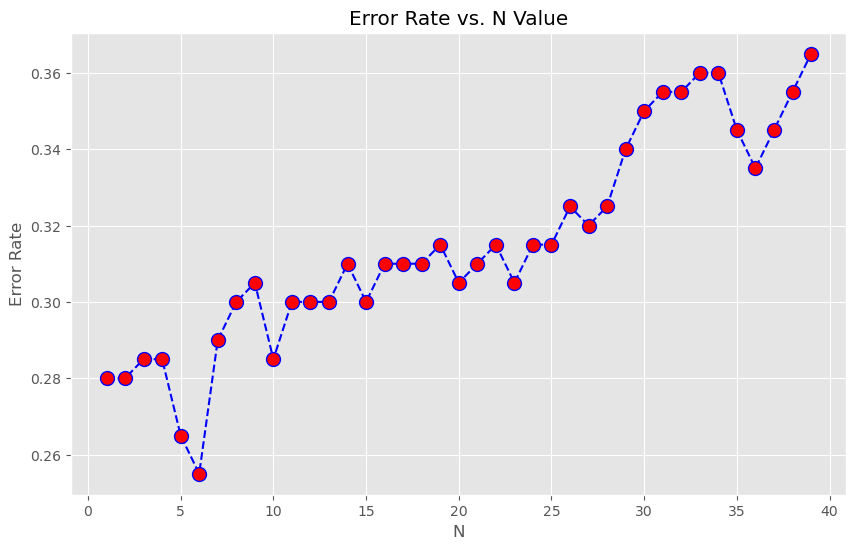

In [16]:
plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue', linestyle='dashed',marker='o',markerfacecolor='red', markersize=10)
plt.title('Error Rate vs. N Value')
plt.xlabel('N')
plt.ylabel('Error Rate')
opt_k_value = error_rate.index(min(error_rate))+1
print("Minimum error:",min(error_rate),"at N =",opt_k_value)

## Optimized KNN Model

Cross Validation accuracy scores: [0.64       0.70666667 0.72       0.70666667 0.68       0.72
 0.68       0.65333333 0.61333333 0.68      ]
Cross Validation accuracy: 0.680 +/- 0.034
K-fold CV average score: 0.68 with K = 10
Stratified K-fold CV average score: 0.67
Accuracy KNN : 0.728 



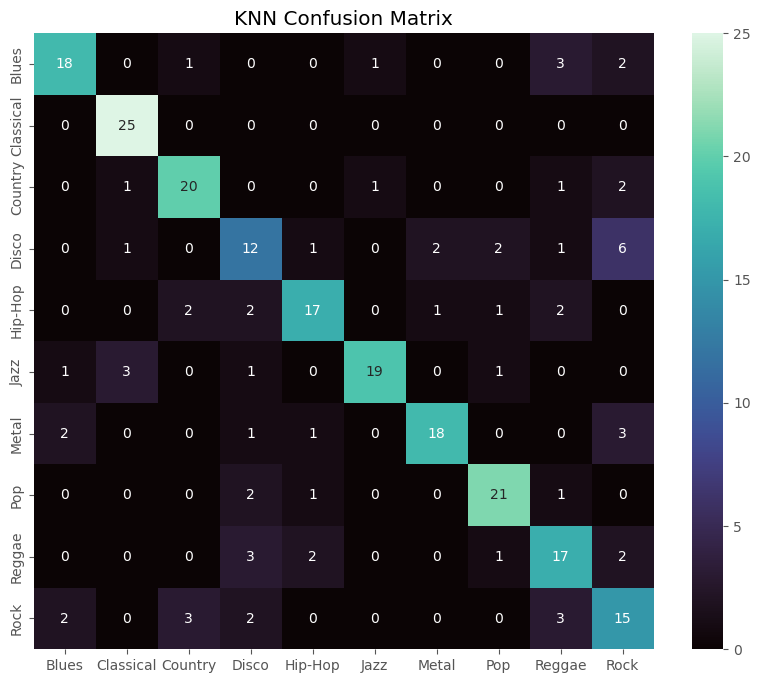

In [10]:
# K-Nearest Neighbor Model
knn = KNeighborsClassifier(n_neighbors = opt_k_value,weights = 'distance')

# Create an instance of Pipeline
pipeline = make_pipeline(MinMaxScaler(), knn)

# Compute Cross-Validation Scores and Print the Average Accuracy Score
scores = cross_val_score(pipeline, X=X_train, y=y_train, cv=k, n_jobs=1)

# Print Accuracy Scores from K-Fold Cross Validation
print('Cross Validation accuracy scores: %s' % scores)
print('Cross Validation accuracy: %.3f +/- %.3f' % (np.mean(scores),np.std(scores)))

# use KFold CV and print mean accuracy scores
kf_cv_scores = cross_val_score(knn,X_train,y_train,cv=kfold)
skf_cv_scores = cross_val_score(knn,X_train,y_train,cv=skfold)
print(f"K-fold CV average score: %.2f with K = {k}" % kf_cv_scores.mean())
print(f"Stratified K-fold CV average score: %.2f" % skf_cv_scores.mean())

# Predict using Model and Plot the Confusion Matrix
knn.fit(X_train,y_train)
y_pred = knn.predict(X_test)

# KNN
model_assess(knn, X_train, y_train, X_test, y_test, "KNN")
plt.figure(figsize = (10,8))
sns.heatmap(confusion_matrix(y_test,y_pred),annot=True,  cmap = 'mako',
            xticklabels = ['Blues','Classical','Country','Disco','Hip-Hop','Jazz','Metal','Pop','Reggae','Rock'],
            yticklabels = ['Blues','Classical','Country','Disco','Hip-Hop','Jazz','Metal','Pop','Reggae','Rock'],
            vmin = 0, vmax = len(y_test)/10)
plt.title('KNN Confusion Matrix')
plt.show()

### Feature Selection using Lasso Regression

In [361]:
# Read CSV file of 10 genres of Music
#df = pd.read_csv('features_3_sec.csv')
df = pd.read_csv('features_30_sec.csv')
df['label'] = df['label'].replace('blues',0)
df['label'] = df['label'].replace('classical',1)
df['label'] = df['label'].replace('country',2)
df['label'] = df['label'].replace('disco',3)
df['label'] = df['label'].replace('hiphop',4)
df['label'] = df['label'].replace('jazz',5)
df['label'] = df['label'].replace('metal',6)
df['label'] = df['label'].replace('pop',7)
df['label'] = df['label'].replace('reggae',8)
df['label'] = df['label'].replace('rock',9)

In [362]:
# Remove irrelevant columns and parse target column from dataset
X = df.drop(['filename','length','label'], axis=1)
y = df['label']

GTZAN_features = X.columns.tolist()
X = X.to_numpy()
y = y.to_numpy()

In [363]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42)

In [364]:
pipeline = Pipeline([
                     ('scaler',StandardScaler()),
                     ('model',Lasso())
])

In [365]:
search = GridSearchCV(pipeline,
                      {'model__alpha':np.arange(0.1,10,0.1)},
                      cv = 5, scoring="neg_mean_squared_error",verbose=3
                      )

In [ ]:
search.fit(X_train,y_train)
search.best_params_

In [367]:
coefficients = search.best_estimator_.named_steps['model'].coef_
importance = np.abs(coefficients)
importance

array([0.0997671 , 0.        , 0.        , 0.19146871, 0.49974584,
       0.07241983, 0.        , 0.        , 0.        , 0.68442517,
       0.        , 0.        , 0.04028613, 0.        , 0.        ,
       0.        , 0.06477752, 0.26346261, 0.        , 0.        ,
       0.        , 0.17202732, 0.        , 0.        , 0.        ,
       0.        , 0.07950544, 0.        , 0.        , 0.01652186,
       0.14651762, 0.        , 0.        , 0.28075513, 0.        ,
       0.        , 0.        , 0.        , 0.07871675, 0.20027255,
       0.08965554, 0.        , 0.2149307 , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.13242113, 0.        , 0.        , 0.        ,
       0.        , 0.        ])

In [ ]:
col_Names = np.array(GTZAN_features)[importance > 0]
col_Names

### Now reduce Dataframe to only the Valueable Features determined from Lasso Regression

In [ ]:
X = df[col_Names]
X

## George's Code

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from timeit import default_timer
from sklearn import preprocessing
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold
from sklearn.naive_bayes import GaussianNB
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.linear_model import Lasso
from sklearn.pipeline import Pipeline
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from mlxtend.feature_selection import SequentialFeatureSelector as SFS
from mlxtend.plotting import plot_sequential_feature_selection as plot_sfs


def main():
    
    filename = 'features_30_sec.csv'
    kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

    print(f'\nfile used: {filename}')
    print(f'Validation method: K-fold cross-validation ({kf.get_n_splits()} splits, stratified)')

    csv = pd.read_csv(filename)
    data = csv.drop(['filename', 'length', 'label'], axis=1)  # remove filename, number of samples from data.
    labels = csv.loc[:,'label'] # extract labels.
    
    cols = data.columns # preprocessing stuff
    scaler = preprocessing.MinMaxScaler()
    scaled_X = scaler.fit_transform(data) 
    data = pd.DataFrame(scaled_X, columns=cols)

    # models
    nb = GaussianNB()
    svm_L = SVC(kernel = 'linear', decision_function_shape="ovr")
    lr = LogisticRegression(random_state=42, multi_class='auto',max_iter=500)
    k = 6 # hardcoded in, was very slow to compute everytime using SFS
    knn = KNeighborsClassifier(n_neighbors=k, weights = 'distance')
    


    print(f'\n-------------------------------------\nInital Feature Comparision\n-------------------------------------')
    sorted_feature_list = get_sorted_features(data, labels, nb, kf)
    print(f'classifying genres pairwise, using the best feature: {sorted_feature_list[:1]}')
    compare_genres_pairwise(data[sorted_feature_list[:1]], labels, nb, 'Naive Bayes', kf) # all features

    
    print(f'\n-------------------------------------\nModel Comparision\n-------------------------------------')
    _, _, best_f_nb, _ = plot_SFS_for_model(nb, 'Naive Bayes', data, labels, kf) 
    _, _, best_f_svm, _ = plot_SFS_for_model(svm_L, 'SVM (linear)', data, labels, kf) 
    _, _, best_f_lr, _ = plot_SFS_for_model(lr, 'Logistic Regression', data, labels, kf) 
    _, _, best_f_knn, _ = plot_SFS_for_model(knn, f'K Neighbors (k = {k})', data, labels, kf) 
    
    compare_genres_pairwise(data[best_f_nb], labels, nb, 'Naive Bayes', kf) # compare pairwise between NB and KNN
    compare_genres_pairwise(data[best_f_knn], labels, knn, f'K Neighbors (k = {k})', kf) # all features


    print(f'\n-------------------------------------\nFinal Feature Comparision\n-------------------------------------')
    combined_list = np.concatenate((best_f_nb, best_f_svm, best_f_lr, best_f_knn))
    combined_list_u, counts = np.unique(combined_list, return_counts=True)
    feature_count = dict(zip(combined_list_u, counts))
    print(f"\nbest features overall: (contributed to the maximum values for all 4 classifiers")
    for i in [k for k,v in feature_count.items() if v == 4]: 
        print(i)
    
    # LASSO coefficients
    # had to hardcode this, was getting a bug
    sorted_features_LASSO = ['rolloff_var', 'spectral_centroid_mean', 'mfcc1_mean', 'spectral_centroid_var', 
                             'mfcc9_mean', 'mfcc12_mean', 'rms_var', 'mfcc3_mean', 'mfcc13_var', 'mfcc18_mean', 
                             'chroma_stft_mean', 'mfcc12_var', 'mfcc7_mean', 'harmony_mean', 'mfcc5_var', 'mfcc11_var', 
                             'mfcc7_var', 'spectral_bandwidth_var', 'tempo']
    print(f'\nThe best features according to the LASSO coefficients ({len(sorted_features_LASSO)} nonzero coefficents):\n')
    print(sorted_features_LASSO)
    print(f'\nusing the classifiers with these features:\n')
 
    print(f'\nmodel: Naive Bayes')
    print(f'average accuracy: {classify(nb, data[sorted_features_LASSO], labels, kf):.3f}')

    print(f'\nmodel: SVM (linear)')
    print(f'average accuracy: {classify(svm_L, data[sorted_features_LASSO], labels, kf):.3f}')

    print(f'\nmodel: Logistic Regression')
    print(f'average accuracy: {classify(lr, data[sorted_features_LASSO], labels, kf):.3f}')

    print(f'\nmodel: K Neighbors (k = 6)')
    print(f'average accuracy: {classify(knn, data[sorted_features_LASSO], labels, kf):.3f}')


    #print(f'\nmodel: K Neighbors') # really slow, computed req_k_value once and then hardcoded it
    #req_k_value, max_acc_knn = get_k(data, labels, kf, verbose=True, disp=True)
    #print(f'average accuracy: {max_acc_knn:.3f}, K={req_k_value}')
    #knn = KNeighborsClassifier(n_neighbors=req_k_value, weights = 'distance')
    
    
    return


def plot_SFS_for_model(model, model_name, data, labels, cv, tol=0.95, disp=True, progress=True, verbose=False):
    #http://rasbt.github.io/mlxtend/user_guide/feature_selection/SequentialFeatureSelector/#sequentialfeatureselector-the-popular-forward-and-backward-feature-selection-approaches-including-floating-variants
    print(f'\nmodel: {model_name}\n')
    
    if progress:
        sfs_verbose = 1
    else:
        sfs_verbose = 0
    
    sfs = SFS(model, 
            k_features=57, 
            forward=True, 
            floating=True, 
            verbose=sfs_verbose,
            scoring='accuracy',
            n_jobs=3,
            cv=cv)
    t1 = default_timer()
    sfs.fit(data, labels)
    t2 = default_timer()
    print(f'\nElapsed time: {t2-t1:.1f} s, {(t2-t1)/60:.1f} m \n') # time results(slow function)
    
    results = pd.DataFrame.from_dict(sfs.get_metric_dict()).T # process results, fixes bug
    results['avg_score'] = pd.to_numeric(results['avg_score'])
    if verbose:
        print(results['avg_score'])
        print()

    all_feature_acc = (results.loc[57]).loc['avg_score']

    n_features_opt = results['avg_score'].idxmax() # calculate best values(max_acc, optimal # features)
    best_result = results.loc[n_features_opt]
    max_acc = best_result.loc['avg_score']
    best_features = list(best_result.loc['feature_names'])

    threshold = tol*max_acc # calculate 'close enough' value, with less features
    threshold_idx = 0
    threshold_acc = 0
    for count, acc in enumerate(results['avg_score']):
        if acc > threshold:
            threshold_acc = acc
            threshold_idx = count+1
            break
    thrs_result = results.loc[threshold_idx]
    thrs_features = list(thrs_result.loc['feature_names'])
 
    print(f'accuracy with all features: {all_feature_acc:.3f}\n')
    print(f'max accuracy = {max_acc:.3f}, at {n_features_opt} features:\n{best_features}\n' )
    print(f'thresh. accuracy = {threshold_acc:.3f}, at {threshold_idx} features:\n{thrs_features}\n' )
    
    if disp:
        fig1 = plot_sfs(sfs.get_metric_dict(), kind='std_dev')
        plt.plot(n_features_opt, max_acc, color='black', markerfacecolor='springgreen', marker='D', markersize=7, label='max acc.')
        plt.plot(threshold_idx, threshold_acc, color='black', markerfacecolor='darkorange', marker='D', markersize=7, label='thr acc.')
        plt.plot(range(1, 58), np.ones(57)*threshold, color='darkorange', linestyle='dashed', label=f'{tol*100}% of max acc.')
        plt.title(f'SFS (w. StdDev)\nModel: {model_name}')
        plt.xticks(ticks=range(5, 58, 5))
        plt.xlim([1, 57])
        plt.ylabel('Accuracy')
        plt.grid()
        plt.legend(loc = 'lower right')
        plt.show()

    return max_acc, threshold_acc, best_features, thrs_features


def get_sorted_features(data, labels, model, kf, verbose=False):
    
    feature_accuracy_dict = {}
    for feature in data.columns:
        feature_data = data[[feature, ]]
        feature_accuracy = classify(model, feature_data, labels, kf)
        feature_accuracy_dict.update({feature:feature_accuracy})
    
    best_feature = max(feature_accuracy_dict, key=feature_accuracy_dict.get)

    print(f'\nclassifying between all genres using a single feature:')
    print(f'average single-feature accuracy: {sum(feature_accuracy_dict.values())/len(feature_accuracy_dict.values()):.3f}')
    print(f'best feature: {best_feature}, accuracy: {max(feature_accuracy_dict.values()):.3f}\n')
    
    if verbose: 
        print('all results:')
    
    sorted_feature_list = []
    for feature in sorted(feature_accuracy_dict, key=feature_accuracy_dict.get, reverse=True):
        sorted_feature_list.append(feature) # get top features, put in list
        if verbose: 
            print(f'{feature}: {feature_accuracy_dict[feature]:.3f}')
    print()

    return sorted_feature_list


def compare_genres_pairwise(data, labels, model, model_name, cv, verbose=False, disp=True):
    
    genres = ['blues', 'classical', 'country', 'disco', 'hiphop', 'jazz', 'metal', 'pop', 'reggae', 'rock' ]
    genre_accuracy_dict = {}
    heatmap = np.empty((len(genres),len(genres)))
    for i in range(len(genres)):
        for j in range(i+1, len(genres)):
            class1 = genres[i]
            class2 = genres[j]
            avg = compare_two_classes(data, labels, class1, class2, model, cv)
            heatmap[j, i] = avg
            heatmap[i, j] = avg
            genre_accuracy_dict.update({class1+' and '+class2:avg})

    best_genres = max(genre_accuracy_dict, key=genre_accuracy_dict.get)
    worst_genres = min(genre_accuracy_dict, key=genre_accuracy_dict.get)
    print(f'average accuracy: {sum(genre_accuracy_dict.values())/len(genre_accuracy_dict.values()):.3f}')
    print(f'best performance between {best_genres}, accuracy: {max(genre_accuracy_dict.values()):.3f}')
    print(f'worst performance between {worst_genres}, accuracy: {min(genre_accuracy_dict.values()):.3f}\n')
    
    if verbose:
        print(f'all results:')
        for w in sorted(genre_accuracy_dict, key=genre_accuracy_dict.get, reverse=True):
            print(f'{w}: {genre_accuracy_dict[w]:.3f}')
        print()

    if disp:
        mask = np.zeros_like(heatmap) # mask top corner
        mask[np.triu_indices_from(mask)] = True
        #mask[np.diag_indices_from(mask)] = True
        ax = sns.heatmap(heatmap, linewidth=0.5, mask=mask, annot=True, fmt=".2f", cmap='mako_r', vmin=0.5, vmax=1.0)
        
        n_feat_title = len(data.columns) # used to title the graph
        ax.set_title(f"Accuracy, pairwise genre classification\n Model: {model_name} \n{n_feat_title} feature(s)")
        plt.yticks(np.arange(0, len(genres))+0.5, genres, rotation='horizontal')
        plt.xticks(np.arange(0, len(genres))+0.5, genres, rotation='horizontal')
        for label in ax.get_xticklabels():
            label.set_horizontalalignment('center')
        plt.show()
        ax.cla()

    return


def compare_two_classes(data, labels, class1, class2, model, cv): 
    
    data_class1 = data.loc[labels==class1]
    data_class2 = data.loc[labels==class2]
    data_2classes = pd.concat([data_class1, data_class2])

    labels_class1 = labels.loc[labels==class1]
    labels_class2 = labels.loc[labels==class2]
    labels_2classes = pd.concat([labels_class1, labels_class2])

    avg = classify(model, data_2classes, labels_2classes, cv)

    return avg


def classify(model, data, labels, cv):
    #print('using K-fold cross validation')
    avg_acc = 0
    for train_index, test_index in cv.split(data, labels):
        #print("TRAIN:", train_index, "TEST:", test_index)
        X_train, X_test = data.iloc[train_index], data.iloc[test_index]
        y_train, y_test = labels.iloc[train_index], labels.iloc[test_index]
        
        #print(f"\nTRAIN:\n", X_train, f"\nTEST:\n", X_test)
        avg_acc += model_assess(model, X_train, y_train, X_test, y_test)/cv.get_n_splits()

    return avg_acc


def model_assess(model, X_train, y_train, X_test, y_test):
    model.fit(X_train,y_train)
    preds=model.predict(X_test)
    accuracy = accuracy_score(y_test, preds)
    return accuracy

# getting a bug where this changes the labels variable in the main function, not really worth it to fix it.
def get_sorted_features_LASSO(csv, printout=False):
    # copied from Tyler's code
    #df = pd.read_csv('features_30_sec.csv')
    df = csv
    df['label'] = df['label'].replace('blues',0)
    df['label'] = df['label'].replace('classical',1)
    df['label'] = df['label'].replace('country',2)
    df['label'] = df['label'].replace('disco',3)
    df['label'] = df['label'].replace('hiphop',4)
    df['label'] = df['label'].replace('jazz',5)
    df['label'] = df['label'].replace('metal',6)
    df['label'] = df['label'].replace('pop',7)
    df['label'] = df['label'].replace('reggae',8)
    df['label'] = df['label'].replace('rock', 9)
    X = df.drop(['filename', 'length', 'label'], axis=1)
    y = df['label']
    GTZAN_features = X.columns.tolist()
    X = X.to_numpy()
    y = y.to_numpy()
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    pipeline = Pipeline([('scaler',StandardScaler()), ('model',Lasso())])
    search = GridSearchCV(pipeline, {'model__alpha':np.arange(0.1,10,0.1)}, cv = 5, scoring="neg_mean_squared_error")
    search.fit(X_train,y_train)
    coefficients = search.best_estimator_.named_steps['model'].coef_
    importance = np.abs(coefficients)
    
    feature_importance_dict = {}
    for i, feature in enumerate(GTZAN_features):
        feature_importance_dict.update({feature:importance[i]})

    if printout:
        print(f'\nLASSO coefficients:')
    sorted_feature_LASSO = []    
    for w in sorted(feature_importance_dict, key=feature_importance_dict.get, reverse=True):
        if printout:
            print(f'{w}: {feature_importance_dict[w]:.3f}')
        if feature_importance_dict[w] > 0.0:
            sorted_feature_LASSO.append(w)

    return sorted_feature_LASSO


def get_k(data, labels, kf, verbose=False, disp=True, fast=True):
    # implementation from tyler's code.
    knn_accuracy = [] 
    n_k = 20
    for k in range(1, n_k+1):
        knn = KNeighborsClassifier(n_neighbors=k, weights = 'distance')
        
        if fast: # fast gives = 5, slow gives k = 6
            max_acc = classify(knn, data, labels, kf)
        else: # this is super slow, prob shouldn't use it.
            max_acc, _, _, _ = plot_SFS_for_model(knn, 'K Neigbors', data, labels, kf, disp=False, progress=False) # do some feature reduction
        
        if verbose:
            print(f'for k  = {k}, average accuracy was {max_acc:.3f}')
        knn_accuracy.append(max_acc)
    
    req_k_value = knn_accuracy.index(max(knn_accuracy))+1
    max_acc_knn = max(knn_accuracy)
    
    if disp:
        plt.plot(range(1,n_k+1), knn_accuracy, color='blue', linestyle='dashed',marker='o',markerfacecolor='red', markersize=5) 
        plt.title('Accuracy vs. K Value')
        plt.xlabel('K')
        plt.ylabel('Accuracy')
        plt.xlim([1, n_k])
        plt.xticks(ticks=range(1,n_k+1))
        plt.grid()
        plt.show()

    return req_k_value, max_acc_knn


if __name__ == '__main__':
    main()